In [1]:
# change the cell width
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
import pandas as pd
pd.set_option('display.max_rows',None)
pd.set_option('display.max_columns', None)

# Importing Libraries

In [3]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import missingno
import matplotlib as mpl
mpl.style.use('ggplot')

In [4]:
print(plt.style.available)

['Solarize_Light2', '_classic_test_patch', 'bmh', 'classic', 'dark_background', 'fast', 'fivethirtyeight', 'ggplot', 'grayscale', 'seaborn', 'seaborn-bright', 'seaborn-colorblind', 'seaborn-dark', 'seaborn-dark-palette', 'seaborn-darkgrid', 'seaborn-deep', 'seaborn-muted', 'seaborn-notebook', 'seaborn-paper', 'seaborn-pastel', 'seaborn-poster', 'seaborn-talk', 'seaborn-ticks', 'seaborn-white', 'seaborn-whitegrid', 'tableau-colorblind10']


# Data Acquisition

In [5]:
# Importing the Train and Test Data
train = pd.read_csv("train_v9rqX0R.csv")
test = pd.read_csv("test_AbJTz2l.csv")

In [6]:
train.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales
0,FDA15,9.30,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380
1,DRC01,5.92,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228
2,FDN15,17.50,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700
3,FDX07,19.20,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800
4,NCD19,8.93,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052


In [7]:
test.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type
0,FDW58,20.750,Low Fat,0.007565,Snack Foods,107.8622,OUT049,1999,Medium,Tier 1,Supermarket Type1
1,FDW14,8.300,reg,0.038428,Dairy,87.3198,OUT017,2007,NaN,Tier 2,Supermarket Type1
2,NCN55,14.600,Low Fat,0.099575,Others,241.7538,OUT010,1998,NaN,Tier 3,Grocery Store
3,FDQ58,7.315,Low Fat,0.015388,Snack Foods,155.0340,OUT017,2007,NaN,Tier 2,Supermarket Type1
4,FDY38,NaN,Regular,0.118599,Dairy,234.2300,OUT027,1985,Medium,Tier 3,Supermarket Type3


In [8]:
# Create a new column for df value labels and assign it to a new DataFrame df1
train1 = train.copy()
train1['Train_Test_Label'] = "Train"

In [9]:
# Create test1 dataframe, a copy of Test and create a new_column for test label
test1 = test.copy()
test1['Train_Test_Label'] = "Test"

In [10]:
# Create DataFrame "df" with df and test labels
df = pd.concat([train1,test1], axis=0, ignore_index=True)

In [11]:
df.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales,Train_Test_Label
0,FDA15,9.30,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380,Train
1,DRC01,5.92,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228,Train
2,FDN15,17.50,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700,Train
3,FDX07,19.20,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800,Train
4,NCD19,8.93,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052,Train


# Basic Statistical Analysis

## Shape and Types of Variables

In [12]:
# Shape of train and test dataset
train.shape, test.shape

((8523, 12), (5681, 11))

In [13]:
# There are 8523 rows and 5681 rows for train and test datasets respectively
# There are 12 columns (including target) and 11 columns (excluding target) for train and test datasets respectively

In [14]:
# The final dataset including train and test values + the train/test labelled coluumn
print("Number of Rows:" , df.shape[0])
print("Number of Columns:" , df.shape[1])

Number of Rows: 14204
Number of Columns: 13


In [15]:
# The overall concatenated dataset (train+test) contains 14204 rows and 13 columns

In [16]:
categorical = list(df.select_dtypes(include="object").columns)
print("Categorical features:\n", categorical)
print("\n")
numerical = list(df.select_dtypes (exclude = "object").columns)
print ("Continous features:\n", numerical)

Categorical features:
 ['Item_Identifier', 'Item_Fat_Content', 'Item_Type', 'Outlet_Identifier', 'Outlet_Size', 'Outlet_Location_Type', 'Outlet_Type', 'Train_Test_Label']


Continous features:
 ['Item_Weight', 'Item_Visibility', 'Item_MRP', 'Outlet_Establishment_Year', 'Item_Outlet_Sales']


## Five-Point Summary

In [17]:
# Five-point summary
df.describe(include="all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Item_Identifier,14204,1559,FDD14,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Item_Weight,11765,NaN,NaN,NaN,12.7929,4.6525,4.555,8.71,12.6,16.75,21.35
Item_Fat_Content,14204,5,Low Fat,8485,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Item_Visibility,14204,NaN,NaN,NaN,0.0659528,0.0514586,0,0.0270357,0.0540205,0.0940373,0.328391
Item_Type,14204,16,Fruits and Vegetables,2013,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Item_MRP,14204,NaN,NaN,NaN,141.005,62.0869,31.29,94.012,142.247,185.856,266.888
Outlet_Identifier,14204,10,OUT027,1559,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Outlet_Establishment_Year,14204,NaN,NaN,NaN,1997.83,8.37166,1985,1987,1999,2004,2009
Outlet_Size,10188,3,Medium,4655,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Outlet_Location_Type,14204,3,Tier 3,5583,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [18]:
# Item_Identifier - Categoric, with FDH12 beig the most frequent Product_ID
# Item_Weight - Numeric, seems to be nearly normal, with average weight being 12.8 (units not mentioned)
# Item_Fat_Content - Categoric, most Items seem to be of the Low Fat category
# Item_Visibility - Numeric, seems to be highly right skewed
# Item_Type - Categoric, we see that most products belong the the Fruits and Vagetables food category
# Item_MRP - Numeric, seems to be slightly right skewed
# Outlet_Identifier - The OUT027 outlet seems to have highest frequency
# Outlet_Establishment_Year - Numeric, seems to be left skewed
# Outlet_Size - Categoric, medium sized outlets seems to be most frequent
# Outlet_Location_Type - Categoric, outlets belonging to Tier 3 cities are most frequent 
# Outlet_Type - Categoric, Outlets seem to be mostly of Supermarket Type1 category
# Item_Outlet_Sales - Numeric, sales of products in stores seems to be highly right skewed

## Observations for Categoric variables

In [19]:
df.dtypes

Item_Identifier               object
Item_Weight                  float64
Item_Fat_Content              object
Item_Visibility              float64
Item_Type                     object
Item_MRP                     float64
Outlet_Identifier             object
Outlet_Establishment_Year      int64
Outlet_Size                   object
Outlet_Location_Type          object
Outlet_Type                   object
Item_Outlet_Sales            float64
Train_Test_Label              object
dtype: object

In [20]:
# The dataset has 3 datatypes, ie object, float and integer
# Item_Identifier, Item_Fat_Content, Item_Type, Outlet_Identifier, Outlet_Size, Outlet_Location_Type, Outlet_Type seem to be object ie string datatype
# Item-Weight, Item_Visibility, Item_MRP, Item_Outlet_Sales are of float datatype
# Outlet_Establishment_Year is the only attribue of Integer datatype

In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14204 entries, 0 to 14203
Data columns (total 13 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Item_Identifier            14204 non-null  object 
 1   Item_Weight                11765 non-null  float64
 2   Item_Fat_Content           14204 non-null  object 
 3   Item_Visibility            14204 non-null  float64
 4   Item_Type                  14204 non-null  object 
 5   Item_MRP                   14204 non-null  float64
 6   Outlet_Identifier          14204 non-null  object 
 7   Outlet_Establishment_Year  14204 non-null  int64  
 8   Outlet_Size                10188 non-null  object 
 9   Outlet_Location_Type       14204 non-null  object 
 10  Outlet_Type                14204 non-null  object 
 11  Item_Outlet_Sales          8523 non-null   float64
 12  Train_Test_Label           14204 non-null  object 
dtypes: float64(4), int64(1), object(8)
memory usag

In [22]:
# Item_Outlet_Sales is our target variable (continuous), which has no Null values
# Item_Weight, Outlet_Size seem to have quite a few Null values
# We would have to further investigate for mixed values for each variable

In [23]:
# This gives the number of categories and % observation in each category.
for i in df.describe(include="object").columns:
    
    print("\n\b ",i)
    print(df[i].value_counts(),"\n")
    print(df[i].value_counts(normalize=True)*100)
    print("\n")


  Item_Identifier
FDD14    10
NCK17    10
DRI11    10
FDR31    10
NCN53    10
FDX26    10
NCG43    10
FDY03    10
FDZ47    10
DRH39    10
FDF08    10
FDZ56    10
FDR15    10
FDT31    10
DRD24    10
DRF15    10
FDT03    10
FDT50    10
FDH21    10
NCC54    10
FDT36    10
FDO36    10
FDV19    10
FDS08    10
FDV21    10
NCB18    10
FDE21    10
FDL13    10
FDH41    10
NCZ30    10
FDW56    10
FDT13    10
FDS21    10
FDO31    10
FDT39    10
FDS47    10
FDH48    10
FDZ26    10
FDV60    10
FDR48    10
FDX21    10
DRA24    10
FDI41    10
FDI20    10
FDB32    10
FDA38    10
FDZ40    10
FDD02    10
FDT56    10
FDQ37    10
FDV52    10
FDU11    10
FDO01    10
FDQ49    10
FDF56    10
FDX46    10
FDE45    10
NCH30    10
FDM60    10
NCX41    10
FDL15    10
FDH14    10
NCP41    10
FDV12    10
FDH32    10
FDY47    10
FDR47    10
FDS03    10
FDF59    10
NCK05    10
NCU18    10
FDG33    10
FDR07    10
FDR19    10
FDI56    10
NCE31    10
FDR46    10
FDD58    10
FDC10    10
FDE35    10
FDP09    10
FDN50   

In [24]:
# Alternate way: This gives the number of categories and % observation in each category.
for i in categorical:
    print("\b Column:", i)
    print(df[i].value_counts()) 
    d = df[i].value_counts()
    j = 0
    for i in d.index:
        print(i, "\t",round(((d[j]/d.sum())*100),2),"%")
        j += 1
    print("\n")

 Column: Item_Identifier
FDD14    10
NCK17    10
DRI11    10
FDR31    10
NCN53    10
FDX26    10
NCG43    10
FDY03    10
FDZ47    10
DRH39    10
FDF08    10
FDZ56    10
FDR15    10
FDT31    10
DRD24    10
DRF15    10
FDT03    10
FDT50    10
FDH21    10
NCC54    10
FDT36    10
FDO36    10
FDV19    10
FDS08    10
FDV21    10
NCB18    10
FDE21    10
FDL13    10
FDH41    10
NCZ30    10
FDW56    10
FDT13    10
FDS21    10
FDO31    10
FDT39    10
FDS47    10
FDH48    10
FDZ26    10
FDV60    10
FDR48    10
FDX21    10
DRA24    10
FDI41    10
FDI20    10
FDB32    10
FDA38    10
FDZ40    10
FDD02    10
FDT56    10
FDQ37    10
FDV52    10
FDU11    10
FDO01    10
FDQ49    10
FDF56    10
FDX46    10
FDE45    10
NCH30    10
FDM60    10
NCX41    10
FDL15    10
FDH14    10
NCP41    10
FDV12    10
FDH32    10
FDY47    10
FDR47    10
FDS03    10
FDF59    10
NCK05    10
NCU18    10
FDG33    10
FDR07    10
FDR19    10
FDI56    10
NCE31    10
FDR46    10
FDD58    10
FDC10    10
FDE35    10
FDP09    10
FD

NCC18 	 0.07 %
FDL40 	 0.07 %
FDB41 	 0.07 %
DRZ24 	 0.07 %
FDT60 	 0.07 %
FDS48 	 0.07 %
FDO11 	 0.07 %
FDA52 	 0.07 %
FDS33 	 0.07 %
FDZ44 	 0.07 %
NCV06 	 0.07 %
DRG48 	 0.07 %
FDQ47 	 0.07 %
FDY09 	 0.07 %
FDY14 	 0.07 %
FDG10 	 0.07 %
FDY02 	 0.07 %
FDP27 	 0.07 %
NCK31 	 0.07 %
FDB17 	 0.07 %
FDW40 	 0.07 %
FDM28 	 0.07 %
FDZ59 	 0.07 %
FDO09 	 0.07 %
DRL49 	 0.07 %
FDZ45 	 0.07 %
FDM51 	 0.07 %
FDR21 	 0.07 %
NCT53 	 0.07 %
DRK13 	 0.07 %
FDI16 	 0.07 %
FDR02 	 0.07 %
DRP47 	 0.07 %
FDO27 	 0.07 %
FDY22 	 0.07 %
FDQ28 	 0.07 %
FDL52 	 0.07 %
FDX13 	 0.07 %
FDF22 	 0.07 %
FDP38 	 0.07 %
FDW12 	 0.07 %
FDD51 	 0.07 %
DRN47 	 0.07 %
FDC20 	 0.07 %
FDP21 	 0.07 %
FDO24 	 0.07 %
FDB03 	 0.07 %
FDM25 	 0.07 %
FDL58 	 0.07 %
FDU38 	 0.07 %
FDB20 	 0.07 %
FDY24 	 0.07 %
FDT51 	 0.07 %
FDC50 	 0.07 %
DRL60 	 0.07 %
DRN37 	 0.07 %
FDI32 	 0.07 %
FDJ26 	 0.07 %
FDV38 	 0.07 %
FDT04 	 0.07 %
NCA29 	 0.07 %
NCH42 	 0.07 %
FDD53 	 0.07 %
NCM05 	 0.07 %
FDG40 	 0.07 %
FDB23 	 0.07 %
FDY31 	 0.

FDK55 	 0.06 %
FDM36 	 0.06 %
FDE40 	 0.06 %
FDV37 	 0.06 %
FDQ33 	 0.06 %
FDC52 	 0.06 %
FDR59 	 0.06 %
FDF17 	 0.06 %
FDF11 	 0.06 %
NCM42 	 0.06 %
FDH02 	 0.06 %
FDF46 	 0.06 %
FDI27 	 0.06 %
FDD36 	 0.06 %
FDQ36 	 0.06 %
FDG02 	 0.06 %
FDB39 	 0.06 %
FDT22 	 0.06 %
DRD60 	 0.06 %
FDK03 	 0.06 %
FDM04 	 0.06 %
FDQ52 	 0.06 %
NCB07 	 0.06 %
FDR36 	 0.06 %
FDJ50 	 0.06 %
NCB55 	 0.06 %
DRB13 	 0.06 %
FDD28 	 0.06 %
FDK45 	 0.06 %
NCI29 	 0.06 %
FDX37 	 0.06 %
FDW46 	 0.06 %
FDX45 	 0.06 %
NCM17 	 0.06 %
FDR43 	 0.06 %
FDK46 	 0.06 %
DRE27 	 0.06 %
FDQ21 	 0.06 %
FDZ01 	 0.06 %
NCK19 	 0.06 %
DRC24 	 0.06 %
FDI34 	 0.06 %
FDV35 	 0.06 %
FDY13 	 0.06 %
NCO26 	 0.06 %
FDB05 	 0.06 %
FDF57 	 0.06 %
FDY38 	 0.06 %
DRB48 	 0.06 %
FDO32 	 0.06 %
FDO49 	 0.06 %
NCA18 	 0.06 %
FDL21 	 0.06 %
FDB57 	 0.06 %
FDO48 	 0.06 %
FDL56 	 0.06 %
FDG44 	 0.06 %
FDC26 	 0.06 %
FDS46 	 0.06 %
DRQ35 	 0.06 %
FDV04 	 0.06 %
FDY04 	 0.06 %
FDX28 	 0.06 %
FDX59 	 0.06 %
DRG27 	 0.06 %
FDG17 	 0.06 %
FDF32 	 0.

FDJ40 	 0.06 %
NCY05 	 0.06 %
FDW22 	 0.06 %
NCZ41 	 0.06 %
FDI58 	 0.06 %
FDG41 	 0.06 %
NCU42 	 0.06 %
FDU16 	 0.06 %
FDS34 	 0.06 %
FDI57 	 0.06 %
FDO52 	 0.06 %
FDJ21 	 0.06 %
FDP08 	 0.06 %
FDR57 	 0.06 %
DRI13 	 0.06 %
FDD34 	 0.06 %
NCO53 	 0.06 %
FDU08 	 0.06 %
FDT02 	 0.06 %
FDE20 	 0.06 %
FDS43 	 0.06 %
FDB51 	 0.06 %
NCT17 	 0.06 %
FDU49 	 0.06 %
FDD23 	 0.06 %
FDG29 	 0.06 %
FDY25 	 0.06 %
DRK11 	 0.06 %
FDZ37 	 0.06 %
FDG05 	 0.06 %
FDK22 	 0.06 %
FDK10 	 0.06 %
NCL42 	 0.05 %
FDI46 	 0.05 %
NCW54 	 0.05 %
FDO33 	 0.05 %
FDR51 	 0.05 %
FDS22 	 0.05 %
FDX49 	 0.05 %
FDL50 	 0.05 %
FDM50 	 0.05 %
DRN11 	 0.05 %
FDM10 	 0.05 %
FDH58 	 0.05 %
FDM52 	 0.05 %


 Column: Item_Fat_Content
Low Fat    8485
Regular    4824
LF          522
reg         195
low fat     178
Name: Item_Fat_Content, dtype: int64
Low Fat 	 59.74 %
Regular 	 33.96 %
LF 	 3.68 %
reg 	 1.37 %
low fat 	 1.25 %


 Column: Item_Type
Fruits and Vegetables    2013
Snack Foods              1989
Household          

## Checking Defects in data 

### Handling Missing Values

In [25]:
df.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales,Train_Test_Label
0,FDA15,9.30,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380,Train
1,DRC01,5.92,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228,Train
2,FDN15,17.50,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700,Train
3,FDX07,19.20,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,NaN,Tier 3,Grocery Store,732.3800,Train
4,NCD19,8.93,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052,Train


In [26]:
# Check the missing vales in the dataset
df.isnull().sum()

Item_Identifier                 0
Item_Weight                  2439
Item_Fat_Content                0
Item_Visibility                 0
Item_Type                       0
Item_MRP                        0
Outlet_Identifier               0
Outlet_Establishment_Year       0
Outlet_Size                  4016
Outlet_Location_Type            0
Outlet_Type                     0
Item_Outlet_Sales            5681
Train_Test_Label                0
dtype: int64

In [27]:
#% of null values
df.isnull().sum () / df.shape[0]*100

Item_Identifier               0.000000
Item_Weight                  17.171219
Item_Fat_Content              0.000000
Item_Visibility               0.000000
Item_Type                     0.000000
Item_MRP                      0.000000
Outlet_Identifier             0.000000
Outlet_Establishment_Year     0.000000
Outlet_Size                  28.273726
Outlet_Location_Type          0.000000
Outlet_Type                   0.000000
Item_Outlet_Sales            39.995776
Train_Test_Label              0.000000
dtype: float64

In [28]:
#To find missing values
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14204 entries, 0 to 14203
Data columns (total 13 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Item_Identifier            14204 non-null  object 
 1   Item_Weight                11765 non-null  float64
 2   Item_Fat_Content           14204 non-null  object 
 3   Item_Visibility            14204 non-null  float64
 4   Item_Type                  14204 non-null  object 
 5   Item_MRP                   14204 non-null  float64
 6   Outlet_Identifier          14204 non-null  object 
 7   Outlet_Establishment_Year  14204 non-null  int64  
 8   Outlet_Size                10188 non-null  object 
 9   Outlet_Location_Type       14204 non-null  object 
 10  Outlet_Type                14204 non-null  object 
 11  Item_Outlet_Sales          8523 non-null   float64
 12  Train_Test_Label           14204 non-null  object 
dtypes: float64(4), int64(1), object(8)
memory usag

In [29]:
# Select only the attributes having missing values
df.isnull().sum()[df.isnull().sum()!=0]

Item_Weight          2439
Outlet_Size          4016
Item_Outlet_Sales    5681
dtype: int64

#### Item_Weight

In [30]:
g1 = df[["Item_Type","Item_Identifier"]].groupby("Item_Type")
g1bg = g1.get_group("Baking Goods")
print(g1bg)

          Item_Type Item_Identifier
5      Baking Goods           FDP36
21     Baking Goods           FDW12
23     Baking Goods           FDC37
48     Baking Goods           FDL12
71     Baking Goods           FDL12
77     Baking Goods           FDN48
84     Baking Goods           FDR12
106    Baking Goods           FDA47
107    Baking Goods           FDG12
156    Baking Goods           FDB36
179    Baking Goods           FDO24
184    Baking Goods           FDT12
201    Baking Goods           FDE36
203    Baking Goods           FDI24
205    Baking Goods           FDF24
220    Baking Goods           FDY24
221    Baking Goods           FDC60
259    Baking Goods           FDS12
267    Baking Goods           FDG24
294    Baking Goods           FDV60
295    Baking Goods           FDY59
296    Baking Goods           FDK36
299    Baking Goods           FDU36
308    Baking Goods           FDX23
321    Baking Goods           FDX36
331    Baking Goods           FDN60
341    Baking Goods         

In [31]:
g1bg['Item_Identifier'].unique()

array(['FDP36', 'FDW12', 'FDC37', 'FDL12', 'FDN48', 'FDR12', 'FDA47',
       'FDG12', 'FDB36', 'FDO24', 'FDT12', 'FDE36', 'FDI24', 'FDF24',
       'FDY24', 'FDC60', 'FDS12', 'FDG24', 'FDV60', 'FDY59', 'FDK36',
       'FDU36', 'FDX23', 'FDX36', 'FDN60', 'FDR24', 'FDX60', 'FDW24',
       'FDM60', 'FDS48', 'FDW23', 'FDE24', 'FDA36', 'FDM24', 'FDK24',
       'FDL48', 'FDZ47', 'FDR60', 'FDR36', 'FDK48', 'FDQ48', 'FDP24',
       'FDA23', 'FDO36', 'FDN12', 'FDL24', 'FDD36', 'FDV12', 'FDJ60',
       'FDZ12', 'FDQ24', 'FDZ23', 'FDP48', 'FDM36', 'FDK60', 'FDY12',
       'FDW48', 'FDP12', 'FDY11', 'FDY60', 'FDY36', 'FDR48', 'FDT48',
       'FDP60', 'FDU60', 'FDH24', 'FDB37', 'FDZ48', 'FDZ36', 'FDB60',
       'FDO48', 'FDF12', 'FDJ36', 'FDU48', 'FDV24', 'FDO60', 'FDB12',
       'FDZ59', 'FDI48', 'FDT24', 'FDW36', 'FDA48', 'FDS24', 'FDQ12',
       'FDL36', 'FDQ36', 'FDV48', 'FDZ60', 'FDM12', 'FDB49', 'FDI12',
       'FDA11', 'FDH12', 'FDU24', 'FDX11', 'FDT60', 'FDJ48', 'FDG60',
       'FDT36', 'FDW

In [32]:
# We understand that every food item is of a particular category under which there are Item Id's to identify 
df[["Item_Identifier","Item_Type"]].groupby("Item_Type").describe()

Item_Identifier                   
                                count unique    top freq
Item_Type                                               
Baking Goods                     1086    119  FDW24   10
Breads                            416     45  FDX35   10
Breakfast                         186     20  FDO01   10
Canned                           1084    120  FDE26   10
Dairy                            1136    125  FDL39   10
Frozen Foods                     1426    155  FDD53   10
Fruits and Vegetables            2013    220  FDR07   10
Hard Drinks                       362     40  DRH11   10
Health and Hygiene                858     95  NCC54   10
Household                        1548    170  NCI30   10
Meat                              736     80  FDQ03   10
Others                            280     30  NCN14   10
Seafood                            89     10  FDG33   10
Snack Foods                      1989    220  FDU45   10
Soft Drinks                       726     80  DRG37   10
Starchy Foods                     269     30  FDC59   10

In [33]:
df[["Item_Weight","Item_Type"]].groupby("Item_Type").describe().T

Item_Type          Baking Goods      Breads   Breakfast      Canned  \
Item_Weight count    900.000000  343.000000  152.000000  898.000000   
            mean      12.275211   11.152362   13.179112   12.340830   
            std        4.744906    4.632099    5.217283    4.625382   
            min        4.880000    4.635000    6.425000    4.615000   
            25%        8.300000    6.710000    8.060000    8.115000   
            50%       11.650000   10.500000   11.600000   12.150000   
            75%       15.750000   14.800000   18.600000   16.500000   
            max       20.850000   20.850000   21.100000   21.350000   

Item_Type               Dairy  Frozen Foods  Fruits and Vegetables  \
Item_Weight count  941.000000   1175.000000            1667.000000   
            mean    13.238358     12.569323              13.194406   
            std      4.662724      4.512750               4.567869   
            min      4.805000      4.555000               5.460000   
            25%      8.930000      8.895000               8.985000   
            50%     13.300000     12.300000              13.100000   
            75%     17.500000     16.200000              17.000000   
            max     20.700000     20.850000              21.350000   

Item_Type          Hard Drinks  Health and Hygiene    Household        Meat  \
Item_Weight count   303.000000          710.000000  1285.000000  607.000000   
            mean     11.576205           13.171739    13.337977   12.766104   
            std       4.229816            4.551038     4.977586    4.650424   
            min       4.610000            5.175000     5.030000    5.150000   
            25%       8.365000            9.695000     8.695000    9.195000   
            50%      10.195000           12.350000    13.000000   12.350000   
            75%      15.000000           17.600000    18.100000   16.750000   
            max      19.700000           21.250000    21.250000   21.250000   

Item_Type              Others    Seafood  Snack Foods  Soft Drinks  \
Item_Weight count  228.000000  73.000000  1653.000000   603.000000   
            mean    13.915724  12.760274    12.865732    11.788408   
            std      4.117886   5.273337     4.547307     4.408126   
            min      5.500000   5.365000     5.095000     4.590000   
            25%     10.895000   7.970000     9.000000     7.970000   
            50%     14.500000  11.650000    12.850000    11.800000   
            75%     17.750000  17.750000    16.850000    15.350000   
            max     20.500000  20.750000    21.250000    20.750000   

Item_Type          Starchy Foods  
Item_Weight count     227.000000  
            mean       13.659758  
            std         4.231526  
            min         6.695000  
            25%        10.500000  
            50%        12.850000  
            75%        17.600000  
            max        21.200000

In [34]:
# we see that all the missing food items are from various food Item Types
df['Item_Type'][df['Item_Weight'].isnull()==True].value_counts()

Fruits and Vegetables    346
Snack Foods              336
Household                263
Frozen Foods             251
Dairy                    195
Canned                   186
Baking Goods             186
Health and Hygiene       148
Meat                     129
Soft Drinks              123
Breads                    73
Hard Drinks               59
Others                    52
Starchy Foods             42
Breakfast                 34
Seafood                   16
Name: Item_Type, dtype: int64

In [35]:
# Example Item Id with no given weight 
df[df.Item_Identifier == "DRG01"]["Item_Weight"]

# Products are kept in box and then the box is labeled.

544      14.8
1218     14.8
3005      NaN
5974      NaN
8522     14.8
10383    14.8
10871    14.8
11785    14.8
13927    14.8
Name: Item_Weight, dtype: float64

In [36]:
# Lambda - Single One Time Loop Function that is created without the need of saving it.
# Use Lambda to fill the values using Mean
# Transform the Column -impute the missing values...

# Group all the IDs & Fill the values based on the Item ID
df["Item_Weight"] = df.groupby("Item_Identifier")["Item_Weight"].transform(lambda x:x.fillna(x.mean()))

In [37]:
df.Item_Weight.isnull().sum()

0

In [38]:
# Check the other Null values
print(df.isnull().sum()[df.isnull().sum()!=0])

Outlet_Size          4016
Item_Outlet_Sales    5681
dtype: int64


#### Outlet_Size

In [39]:
# The size of the outlet depends on the Location and the Type of City where the Outlet is located in 

In [40]:
pd.DataFrame(df.groupby(["Outlet_Size","Outlet_Location_Type"])["Outlet_Type"].value_counts().T)

Outlet_Type
Outlet_Size Outlet_Location_Type Outlet_Type                   
High        Tier 3               Supermarket Type1         1553
Medium      Tier 1               Supermarket Type1         1550
            Tier 3               Supermarket Type3         1559
                                 Supermarket Type2         1546
Small       Tier 1               Supermarket Type1         1550
                                 Grocery Store              880
            Tier 2               Supermarket Type1         1550

In [41]:
# Also, There are no grocery stores in Tier 2 cities
# There are no Supermarket Type 2 & 3 in Tier 1,2 cities

# 1. Medium Outlets are S1, S2 and S3.
# 2. High Spaced Outlets are S1 only
# 3. S1 is Small in Tier 1 and Tier 2 and we have Grocery Stores.

In [42]:
pd.DataFrame(df.groupby(["Outlet_Location_Type","Outlet_Type"])["Outlet_Size"].value_counts().T)

Outlet_Size
Outlet_Location_Type Outlet_Type       Outlet_Size             
Tier 1               Grocery Store     Small                880
                     Supermarket Type1 Medium              1550
                                       Small               1550
Tier 2               Supermarket Type1 Small               1550
Tier 3               Supermarket Type1 High                1553
                     Supermarket Type2 Medium              1546
                     Supermarket Type3 Medium              1559

In [43]:
out = df[["Outlet_Type","Outlet_Location_Type"]][df["Outlet_Size"].isnull()]
print(out["Outlet_Type"].mode())
print(out["Outlet_Location_Type"].mode())

0    Supermarket Type1
dtype: object
0    Tier 2
dtype: object


In [44]:
# Hence we will impute the null value is Outlet_Size as Small, as most of the null values are from Supermarket Type1 and belonging to Tier 2 cities

In [45]:
df.loc[df.Outlet_Size.isnull(), "Outlet_Size"] = "Small"

In [46]:
df['Outlet_Size'].isnull().sum()

0

In [47]:
# Check the other Null values
print(df.isnull().sum()[df.isnull().sum()!=0])

Item_Outlet_Sales    5681
dtype: int64


#### Item_Outlet_Sales

In [48]:
train.shape

(8523, 12)

In [49]:
test.shape

(5681, 11)

In [50]:
df['Item_Outlet_Sales'].isnull().sum()

5681

In [51]:
# The null values are from the test dataset which we need to predict, hence we ignore the column

### Outlier Detection and Analysis

-------------------- Feature Name:  Item_Weight --------------------

 Skewness for Item_Weight is 0.10041690891741958
 Kurtosis for Item_Weight is -1.2274197028905338


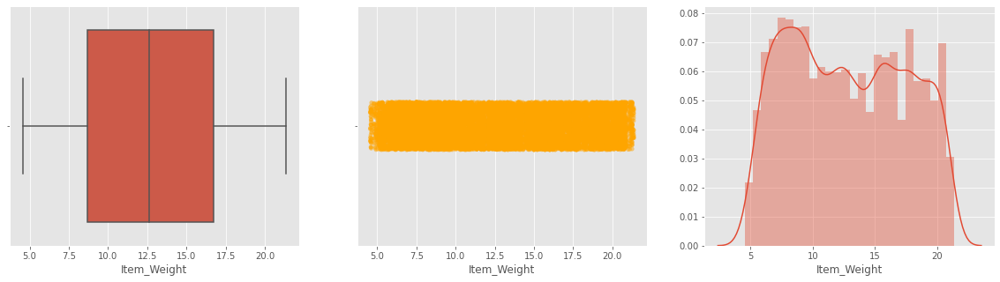



-------------------- Feature Name:  Item_Visibility --------------------

 Skewness for Item_Visibility is 1.1951751774587889
 Kurtosis for Item_Visibility is 1.8200714679841465


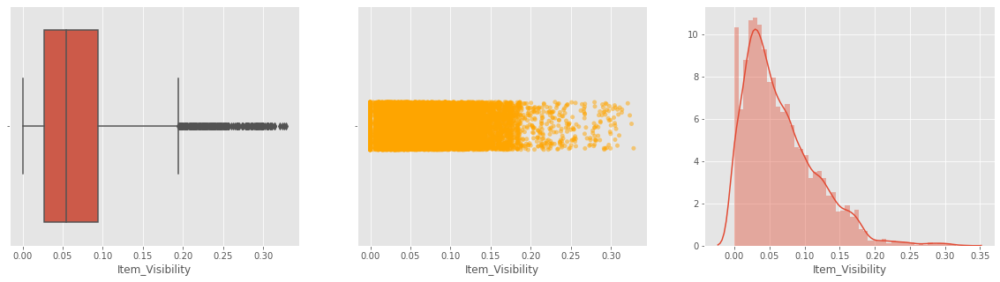



-------------------- Feature Name:  Item_MRP --------------------

 Skewness for Item_MRP is 0.13072836040225863
 Kurtosis for Item_MRP is -0.8938560053756124


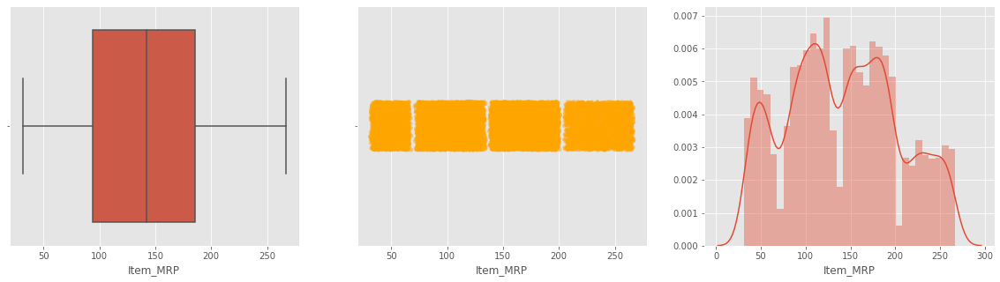



-------------------- Feature Name:  Outlet_Establishment_Year --------------------

 Skewness for Outlet_Establishment_Year is -0.39646519008637443
 Kurtosis for Outlet_Establishment_Year is -1.2058671747532432


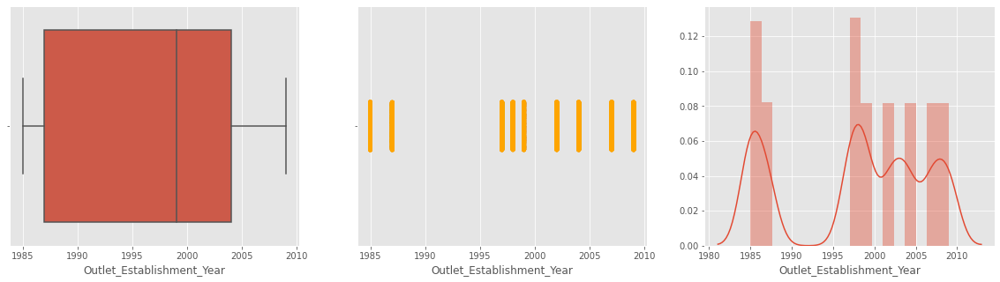



-------------------- Feature Name:  Item_Outlet_Sales --------------------

 Skewness for Item_Outlet_Sales is 1.1775306028542798
 Kurtosis for Item_Outlet_Sales is 1.6158766814287264


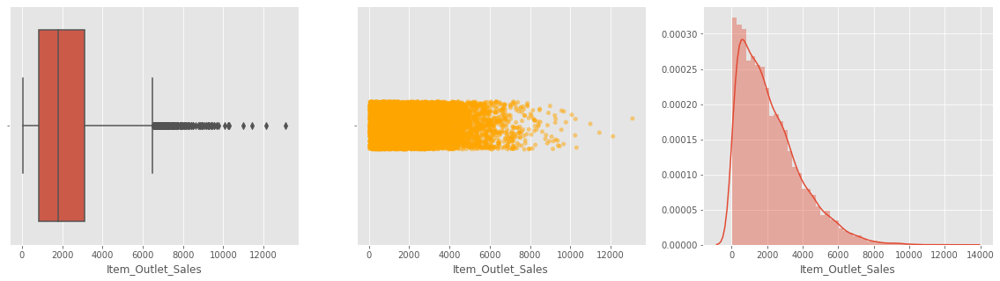

In [52]:
for i in numerical:
    fig, axes = plt.subplots(1,3, figsize=(20,5))
    print("-------------------- Feature Name: ",i,"--------------------")
    sns.boxplot(df[i], ax=axes[0])
    sns.stripplot(df[i], jitter=True, dodge=True, marker='o', alpha=0.5, color="orange", ax=axes[1])
    sns.distplot(df[i])
    print ( "\n Skewness for" , i , "is" , df[ i ].skew())
    print ( " Kurtosis for" , i , "is" , df[ i ].kurt())
    plt.show()
    print("\n")

In [53]:
# we see that Item_Visibility and Item_Output_Sales have the outliers

In [54]:
# There are outliers only for Item Visibility
df.shape

(14204, 13)

#### IQR method

In [55]:
# Inter-Quartile range for each column
Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)
IQR = Q3 - Q1
lower_range = Q1 - (1.5 * IQR)
upper_range = Q3 + (1.5 * IQR)
print(IQR)

Item_Weight                     8.040000
Item_Visibility                 0.067002
Item_MRP                       91.843600
Outlet_Establishment_Year      17.000000
Item_Outlet_Sales            2267.049000
dtype: float64


In [56]:
# Finding if the data is an outlier or not
(df < lower_range) | (df > upper_range)

,Item_Fat_Content,Item_Identifier,Item_MRP,Item_Outlet_Sales,Item_Type,Item_Visibility,Item_Weight,Outlet_Establishment_Year,Outlet_Identifier,Outlet_Location_Type,Outlet_Size,Outlet_Type,Train_Test_Label
0,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False,False
5,False,False,False,False,False,False,False,False,False,False,False,False,False
6,False,False,False,False,False,False,False,False,False,False,False,False,False
7,False,False,False,False,False,False,False,False,False,False,False,False,False
8,False,False,False,False,False,False,False,False,False,False,False,False,False
9,False,False,False,False,False,False,False,False,False,False,False,False,False


In [57]:
# Excluding the data with outliers 
df_IQR = df[~((df < (lower_range)) |(df > (upper_range))).any(axis=1)]
df_IQR.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales,Train_Test_Label
0,FDA15,9.30,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380,Train
1,DRC01,5.92,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228,Train
2,FDN15,17.50,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700,Train
3,FDX07,19.20,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,Small,Tier 3,Grocery Store,732.3800,Train
4,NCD19,8.93,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052,Train


In [58]:
print("Original data shape ",df.shape)
print("Outlier removed data using IQR ",df_IQR.shape)

Original data shape  (14204, 13)
Outlier removed data using IQR  (13757, 13)


-------------------- Feature Name:  Item_Weight --------------------

 Skewness for Item_Weight is 0.09840521302763683
 Kurtosis for Item_Weight is -1.2288636318224666


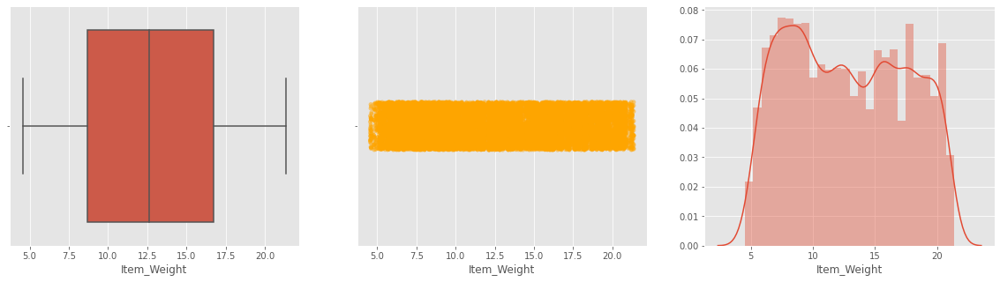



-------------------- Feature Name:  Item_Visibility --------------------

 Skewness for Item_Visibility is 0.7291918318629884
 Kurtosis for Item_Visibility is -0.2563770477321463


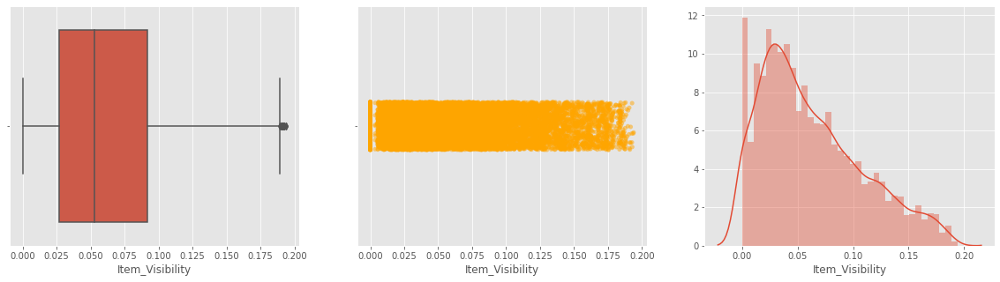



-------------------- Feature Name:  Item_MRP --------------------

 Skewness for Item_MRP is 0.14352192620732482
 Kurtosis for Item_MRP is -0.8731905664527542


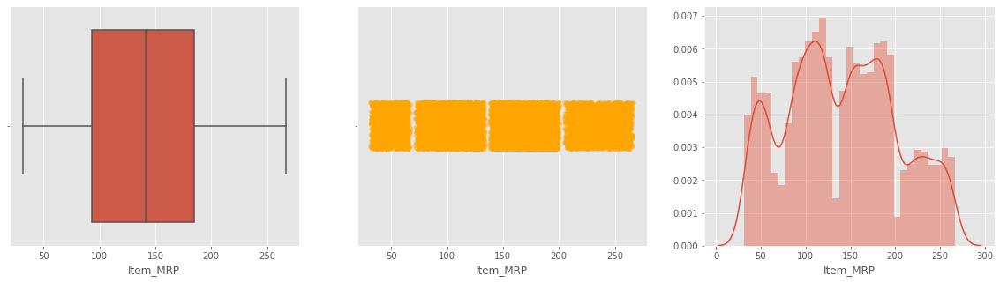



-------------------- Feature Name:  Outlet_Establishment_Year --------------------

 Skewness for Outlet_Establishment_Year is -0.4292007865298333
 Kurtosis for Outlet_Establishment_Year is -1.1624752569335748


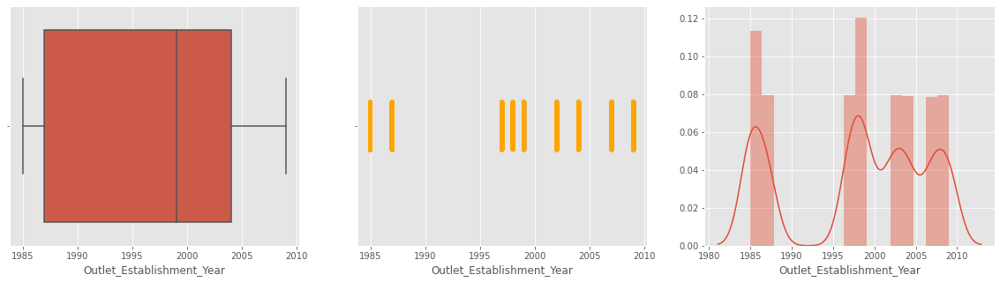



-------------------- Feature Name:  Item_Outlet_Sales --------------------

 Skewness for Item_Outlet_Sales is 0.7683271718715573
 Kurtosis for Item_Outlet_Sales is -0.12980951069887148


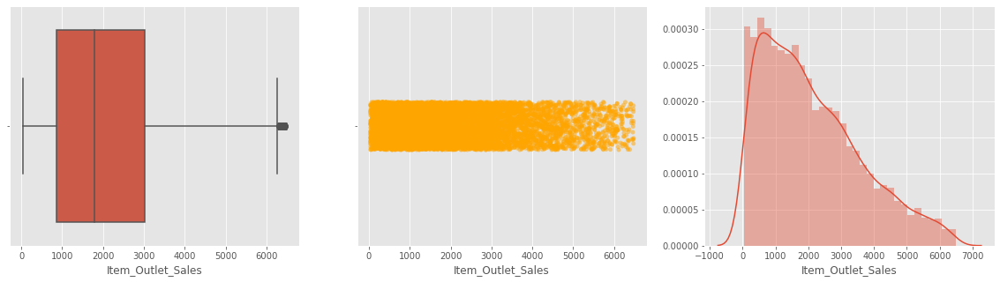

In [59]:
for i in numerical:
    fig, axes = plt.subplots(1,3, figsize=(20,5))
    print("-------------------- Feature Name: ",i,"--------------------")
    sns.boxplot(df_IQR[i], ax=axes[0])
    sns.stripplot(df_IQR[i], jitter=True, dodge=True, marker='o', alpha=0.5, color="orange", ax=axes[1])
    sns.distplot(df_IQR[i])
    print ( "\n Skewness for" , i , "is" , df_IQR[ i ].skew())
    print ( " Kurtosis for" , i , "is" , df_IQR[ i ].kurt())
    plt.show()
    print("\n")

#### Z_Score method

In [60]:
from scipy import stats
import numpy as np
z = np.abs(stats.zscore(df[['Item_Weight', 'Item_Visibility', 'Item_MRP','Item_Outlet_Sales']], nan_policy='omit'))
print(z)

[[0.75101393 0.96985228 1.75251118 0.910601  ]
 [1.47765312 0.90706338 1.4936965  1.01844035]
 [1.01183853 0.95600038 0.00987397 0.04923754]
 ...
 [0.60052652 0.14722609 0.35855788        nan]
 [0.53887812 1.28171205 1.18574722        nan]
 [0.70801753 0.7533967  0.98589388        nan]]


In [61]:
# Identifying Outliers in Train data
threshold = 3
print(np.where(z > 3))

(array([   49,    83,   108,   130,   145,   174,   276,   304,   333,
         373,   434,   456,   472,   502,   521,   532,   661,   694,
         753,   809,   854,   935,   991,   997,  1009,  1138,  1159,
        1254,  1272,  1291,  1311,  1324,  1434,  1450,  1496,  1501,
        1506,  1560,  1575,  1644,  1651,  1805,  1827,  1841,  1859,
        1998,  2088,  2109,  2122,  2216,  2238,  2251,  2293,  2324,
        2439,  2445,  2516,  2535,  2586,  2613,  2728,  2776,  2855,
        2895,  3017,  3083,  3087,  3098,  3154,  3206,  3234,  3286,
        3399,  3407,  3458,  3474,  3488,  3497,  3540,  3667,  3709,
        3720,  3750,  3757,  3767,  3884,  3993,  4006,  4219,  4289,
        4346,  4349,  4382,  4408,  4530,  4656,  4674,  4676,  4681,
        4772,  4789,  4888,  4941,  4961,  4991,  5031,  5065,  5150,
        5177,  5185,  5223,  5287,  5315,  5374,  5500,  5550,  5619,
        5732,  5734,  5752,  5795,  5799,  5812,  5837,  5880,  5891,
        5946,  5977

In [62]:
df_z = df[(z < 3).all(axis=1)]
df_z

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales,Train_Test_Label
0,FDA15,9.300,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380,Train
1,DRC01,5.920,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228,Train
2,FDN15,17.500,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700,Train
3,FDX07,19.200,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,Small,Tier 3,Grocery Store,732.3800,Train
4,NCD19,8.930,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052,Train
5,FDP36,10.395,Regular,0.000000,Baking Goods,51.4008,OUT018,2009,Medium,Tier 3,Supermarket Type2,556.6088,Train
6,FDO10,13.650,Regular,0.012741,Snack Foods,57.6588,OUT013,1987,High,Tier 3,Supermarket Type1,343.5528,Train
7,FDP10,19.000,Low Fat,0.127470,Snack Foods,107.7622,OUT027,1985,Medium,Tier 3,Supermarket Type3,4022.7636,Train
8,FDH17,16.200,Regular,0.016687,Frozen Foods,96.9726,OUT045,2002,Small,Tier 2,Supermarket Type1,1076.5986,Train
9,FDU28,19.200,Regular,0.094450,Frozen Foods,187.8214,OUT017,2007,Small,Tier 2,Supermarket Type1,4710.5350,Train


In [63]:
print("Original data shape ",df.shape)
print("Outlier removed data using IQR ",df_IQR.shape)
print("Outlier removed data using Z-Score",df_z.shape)

Original data shape  (14204, 13)
Outlier removed data using IQR  (13757, 13)
Outlier removed data using Z-Score (8338, 13)


In [64]:
# IQR seems a more reasonable method to remove Outliers as compared to z-score

In [65]:
loss_of_rows = df.shape[0] - df_IQR.shape[0]
print('After treating for outliers number of records(rows) lost using IQR method is : ', loss_of_rows)

After treating for outliers number of records(rows) lost using IQR method is :  447


In [66]:
# Using IQR method for outlier removal we were able to free the data off 3% of data (outliers), which is reasonably good. 
# We would further use this for our analysis.

### Distribution of the target variable

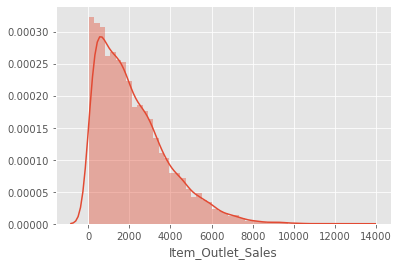


 Skewness for Item_Outlet_Sales is 1.1775306028542798
 Kurtosis for Item_Outlet_Sales is 1.6158766814287264


In [67]:
# Before treating Outliers
sns.distplot(df['Item_Outlet_Sales'])
plt.show()
print ( "\n Skewness for Item_Outlet_Sales is" , df['Item_Outlet_Sales'].skew())
print ( " Kurtosis for Item_Outlet_Sales is" , df['Item_Outlet_Sales'].kurt())

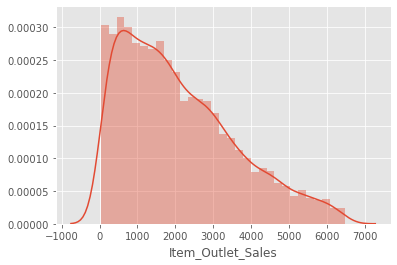


 Skewness for Item_Outlet_Sales is 0.7683271718715573
 Kurtosis for Item_Outlet_Sales is -0.12980951069887148


In [68]:
# After imputing Null values and treating Outliers
sns.distplot(df_IQR['Item_Outlet_Sales'])
plt.show()
print ( "\n Skewness for Item_Outlet_Sales is" , df_IQR['Item_Outlet_Sales'].skew())
print ( " Kurtosis for Item_Outlet_Sales is" , df_IQR['Item_Outlet_Sales'].kurt())

In [69]:
# After outlier removal using IQR, we see that the target variable has lessened skewness and kurtosis.

nan 1.0


C:\ProgramData\Anaconda3\lib\site-packages\scipy\stats\morestats.py:1681: UserWarning: p-value may not be accurate for N > 5000.
  warnings.warn("p-value may not be accurate for N > 5000.")


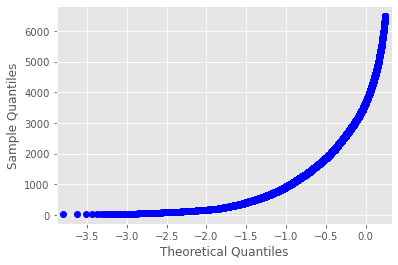

In [70]:
from scipy import stats
from scipy.stats import norm
from scipy.stats import shapiro
from statsmodels.graphics.gofplots import qqplot

qqplot(df_IQR['Item_Outlet_Sales'], line='s')
W, p_value = shapiro(df_IQR['Item_Outlet_Sales'])
print(W, p_value)
plt.show()

In [71]:
# target is not normally distributed

## Relationship between variables

In [72]:
# Corelation Table
train.corr()

,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year,Item_Outlet_Sales
Item_Weight,1.000000,-0.014048,0.027141,-0.011588,0.014123
Item_Visibility,-0.014048,1.000000,-0.001315,-0.074834,-0.128625
Item_MRP,0.027141,-0.001315,1.000000,0.005020,0.567574
Outlet_Establishment_Year,-0.011588,-0.074834,0.005020,1.000000,-0.049135
Item_Outlet_Sales,0.014123,-0.128625,0.567574,-0.049135,1.000000


In [73]:
# We see that the Item_MRP has a moderate correlation with Item_Out_sales, while the rest of the numerical attributes in the train data show weak/ almost no linear relationship with other attributes

In [74]:
# Corelation Table
test.corr()

,Item_Weight,Item_Visibility,Item_MRP,Outlet_Establishment_Year
Item_Weight,1.000000,-0.019089,0.049809,0.018918
Item_Visibility,-0.019089,1.000000,-0.014013,-0.097040
Item_MRP,0.049809,-0.014013,1.000000,-0.007233
Outlet_Establishment_Year,0.018918,-0.097040,-0.007233,1.000000


In [75]:
# We see that all numerical attributes show weak/ almost no linear relationship with each other

### Visualizing Relationships between Variables

In [76]:
# sns.pairplot(df)
# plt.show()

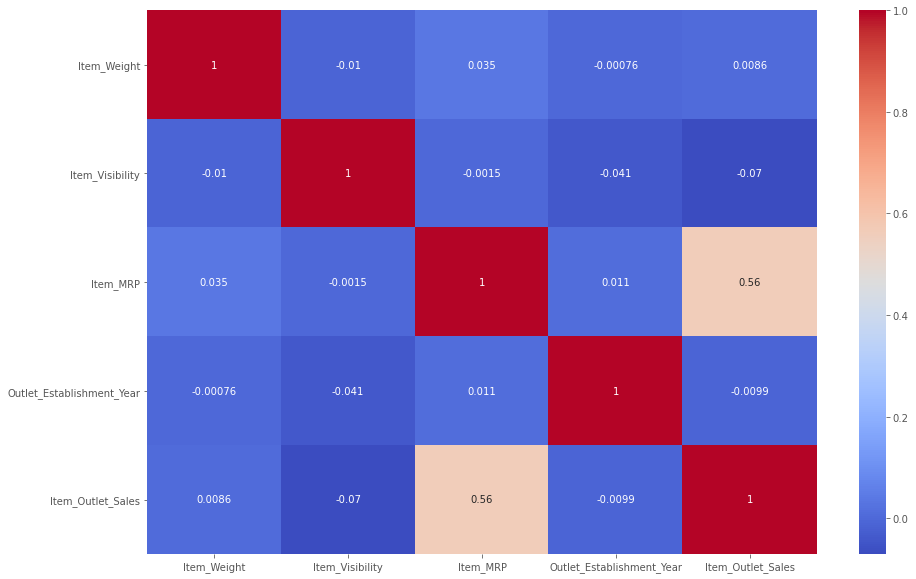

In [77]:
#correlation plot:
plt.figure(figsize = (15,10))
sns.heatmap(df_IQR.corr(), annot = True, cmap='coolwarm')
plt.show()

In [78]:
corr = df_IQR.corr()
corr_target = corr['Item_Outlet_Sales']
corr_target

Item_Weight                  0.008628
Item_Visibility             -0.070335
Item_MRP                     0.564568
Outlet_Establishment_Year   -0.009914
Item_Outlet_Sales            1.000000
Name: Item_Outlet_Sales, dtype: float64

In [79]:
# We see that only Item_MRP shows a moderate correlation with Item_Outlet_Sales

### Linearity  wrt Target

Correlation of Item_Outlet_Sales with Item_Weight is: 0.009


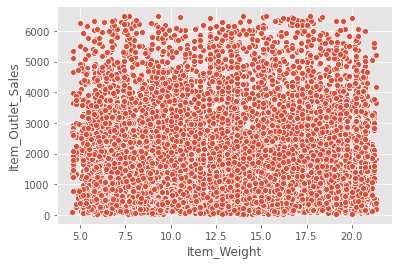

Correlation of Item_Outlet_Sales with Item_Visibility is: -0.07


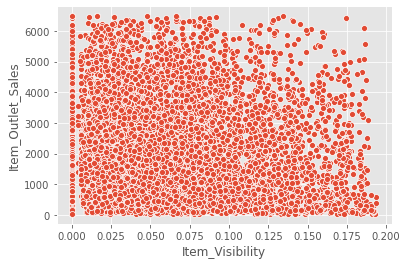

Correlation of Item_Outlet_Sales with Item_MRP is: 0.565


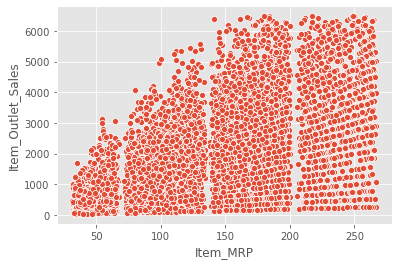

Correlation of Item_Outlet_Sales with Outlet_Establishment_Year is: -0.01


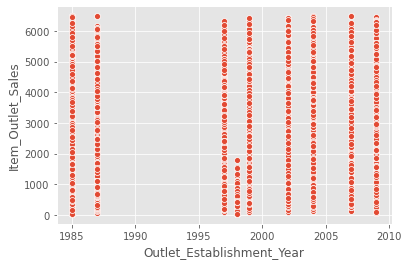

In [80]:
j = 0
for i in corr_target.index:
    if i == "Item_Outlet_Sales":
        break
    else:
        print("Correlation of Item_Outlet_Sales with", i,"is:", round(corr_target[j], 3))
        j += 1
        sns.scatterplot(df_IQR[i], df_IQR["Item_Outlet_Sales"])
        plt.show()

In [81]:
# None of the independent variables form a linear relationship with the target variable Item_Outlet_Sales

# Exploratory Data Analysis

## Univariate Data Analysis

In [82]:
df.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales,Train_Test_Label
0,FDA15,9.30,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380,Train
1,DRC01,5.92,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228,Train
2,FDN15,17.50,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700,Train
3,FDX07,19.20,Regular,0.000000,Fruits and Vegetables,182.0950,OUT010,1998,Small,Tier 3,Grocery Store,732.3800,Train
4,NCD19,8.93,Low Fat,0.000000,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052,Train


### Categoric

In [83]:
# Find the categoric data in the dataset
df.describe(include="object").columns

Index(['Item_Identifier', 'Item_Fat_Content', 'Item_Type', 'Outlet_Identifier',
       'Outlet_Size', 'Outlet_Location_Type', 'Outlet_Type',
       'Train_Test_Label'],
      dtype='object')

In [84]:
# Alternate way: Find the categoric data in the dataset
df.select_dtypes(include="object").columns

Index(['Item_Identifier', 'Item_Fat_Content', 'Item_Type', 'Outlet_Identifier',
       'Outlet_Size', 'Outlet_Location_Type', 'Outlet_Type',
       'Train_Test_Label'],
      dtype='object')

#### Item_Identifier

In [85]:
# There is no use of plotting the Item ID of the foods in BigMart Sales

#### Item_Fat_Content

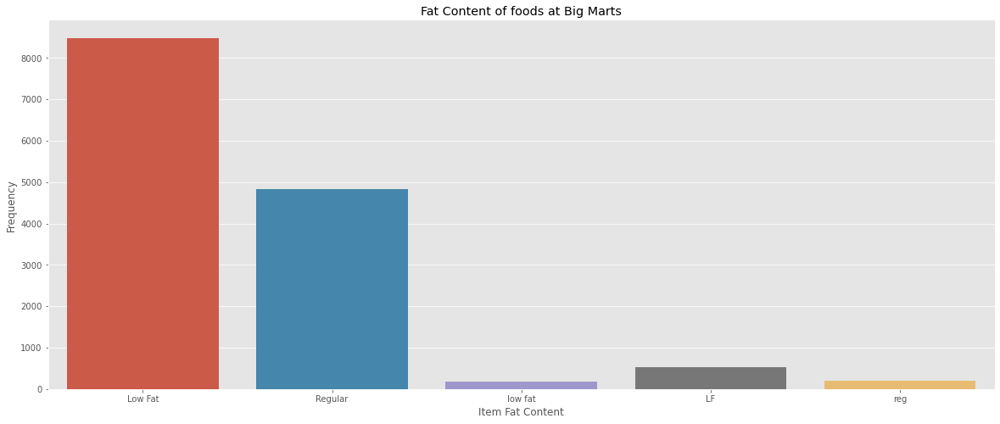

In [86]:
plt.figure(figsize=(20,8))

# Using the Artist Layer
ax = sns.countplot(df['Item_Fat_Content'])
ax.set_xlabel("Item Fat Content")
ax.set_ylabel("Frequency")
ax.set_title("Fat Content of foods at Big Marts")

# Remove top and right borders
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.show()

In [87]:
# We observe that the food with low fat content is being used in 3 categories, which we will convert to 1 category: Low Fat 
# The same is being seen for regular food which we will convert to Regular

In [88]:
# Replacing the repetitive categories with the Relevant Categories of Food Fat Content
df['Item_Fat_Content'] = df['Item_Fat_Content'].replace(to_replace=['low fat','LF','reg'], value=['Low Fat','Low Fat','Regular'])
df['Item_Fat_Content'].value_counts()

Low Fat    9185
Regular    5019
Name: Item_Fat_Content, dtype: int64

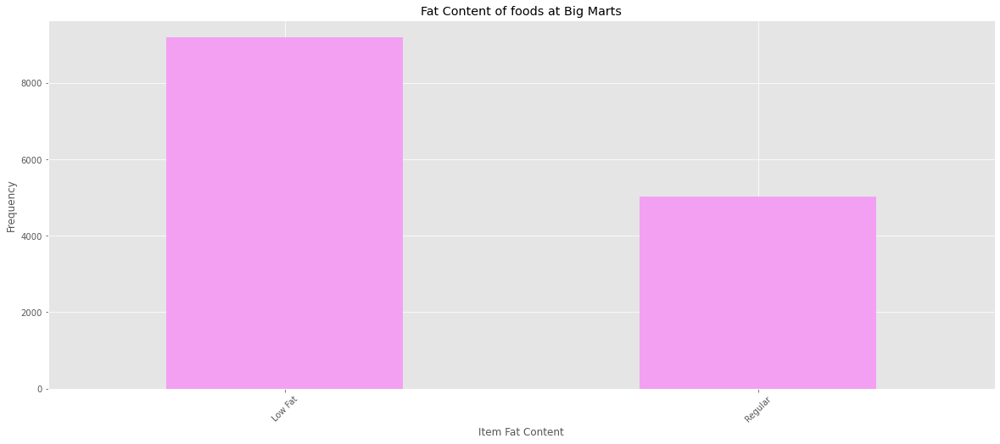

In [89]:
plt.figure(figsize=(20,8))

df['Item_Fat_Content'].value_counts().plot(kind='bar', title="Fat Content of foods at Big Marts", color="#F3A0F2")
plt.xlabel("Item Fat Content")
plt.ylabel("Frequency")
plt.xticks(rotation=45)
plt.show()

In [90]:
# We see that Low Fat content is sold in Big marts much more than Regular food
# We can infer that people are more health concsious which justifies the number of low fat food content as compared to refular food content

#### Item_Type

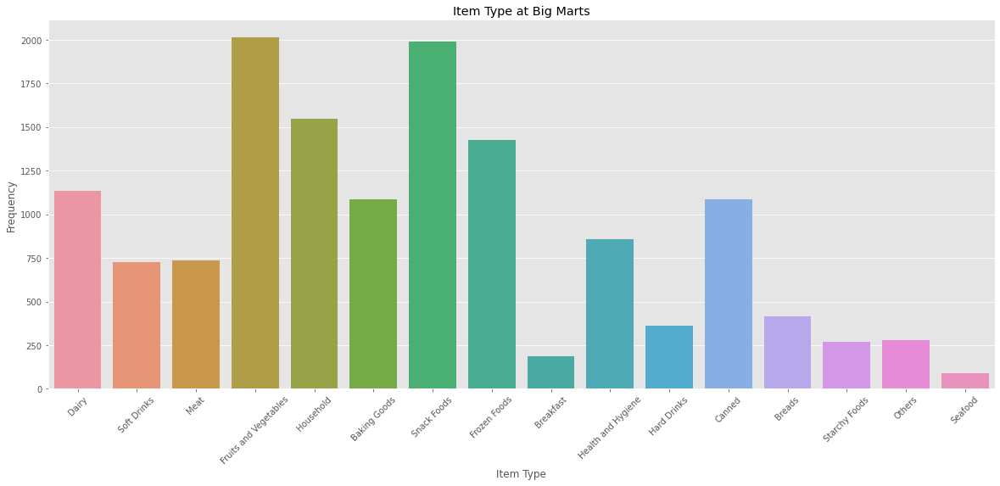

In [91]:
plt.figure(figsize=(20,8))

# Using the Artist Layer
ax = sns.countplot(df['Item_Type'])
ax.set_xlabel("Item Type")
ax.set_ylabel("Frequency")
ax.set_title("Item Type at Big Marts")
ax.set_xticklabels(ax.get_xticklabels(), rotation=45)

# Remove top and right borders
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
   
plt.show()

In [92]:
# Top 5 foods are Fruits and Vegetables, Dairy, Household, Snack Foods & Frozen foods
# Seafoods seems to be the least in quantity closely followed by Breakfast foods

#### Outlet_Id

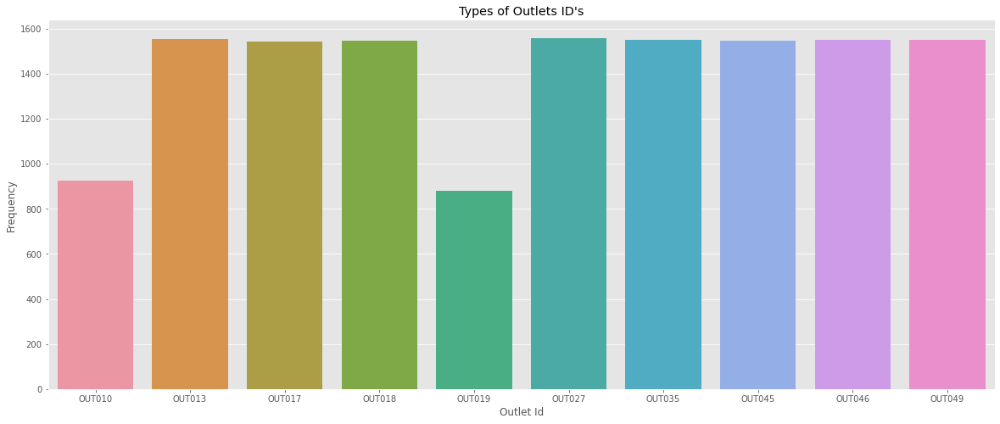

In [93]:
plt.figure(figsize=(20,8))

# Using the Artist Layer
ax = sns.countplot(df['Outlet_Identifier'].sort_values())
ax.set_xlabel("Outlet Id")
ax.set_ylabel("Frequency")
ax.set_title("Types of Outlets ID's")

# Remove top and right borders
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.show()

In [94]:
# OUTLET 27 is the Most Avilable Type of Outlet. (after further analysis)
# Less No of OUTLETS - OUTLET10 & OUTLET19

#### Outlet_Size

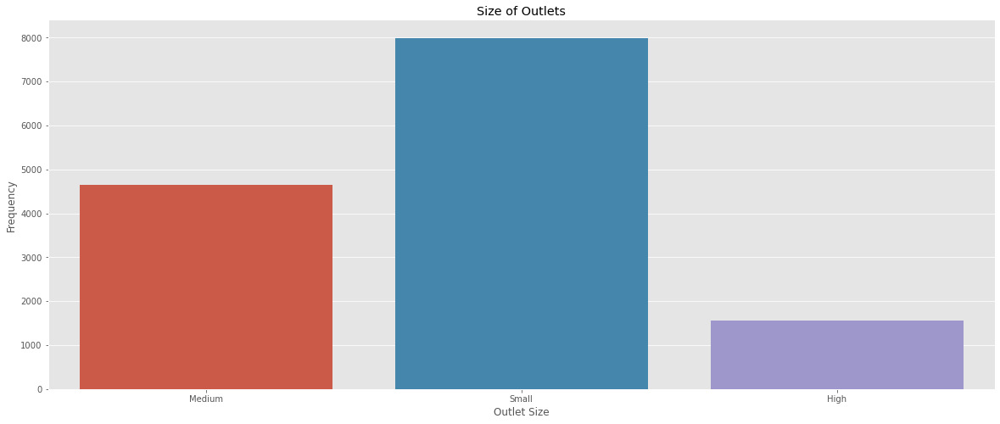

In [95]:
plt.figure(figsize=(20,8))

# Using the Artist Layer
ax = sns.countplot(df['Outlet_Size'])
ax.set_xlabel("Outlet Size")
ax.set_ylabel("Frequency")
ax.set_title("Size of Outlets")

# Remove top and right borders
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.show()

In [96]:
# Medium Size Outlets are the most visible outlets in the market followed by Smaller Outlets
# High sized outlets seem to be least as the operating cost are usually higher

#### Outlet_Location_Type

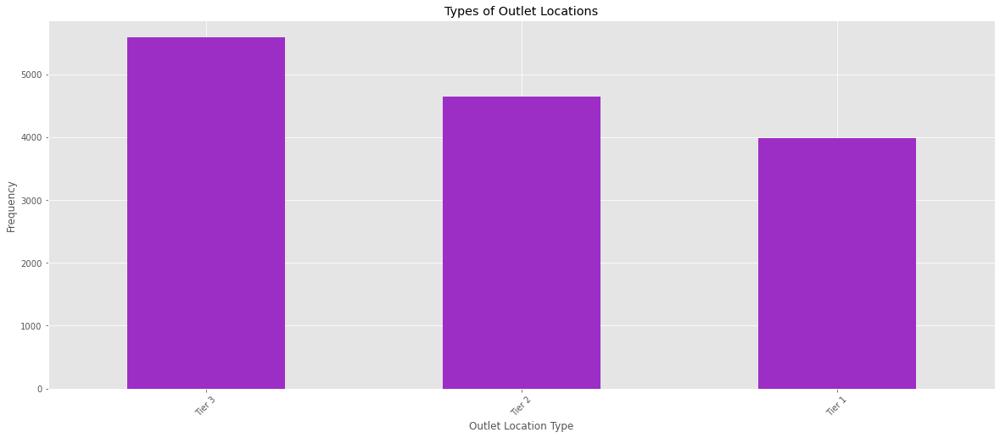

In [97]:
plt.figure(figsize=(20,8))

df['Outlet_Location_Type'].value_counts().plot(kind='bar', title="Types of Outlet Locations", color="#9D2EC5")
plt.xlabel("Outlet Location Type")
plt.ylabel("Frequency")
plt.xticks(rotation=45)
plt.show()

In [98]:
# Majority of the outlets are of Tier3 followed by Tier2 and Tier1 locations
# Tier3 locations would be cities having high population densities attracting more customers

#### Outlet_Type

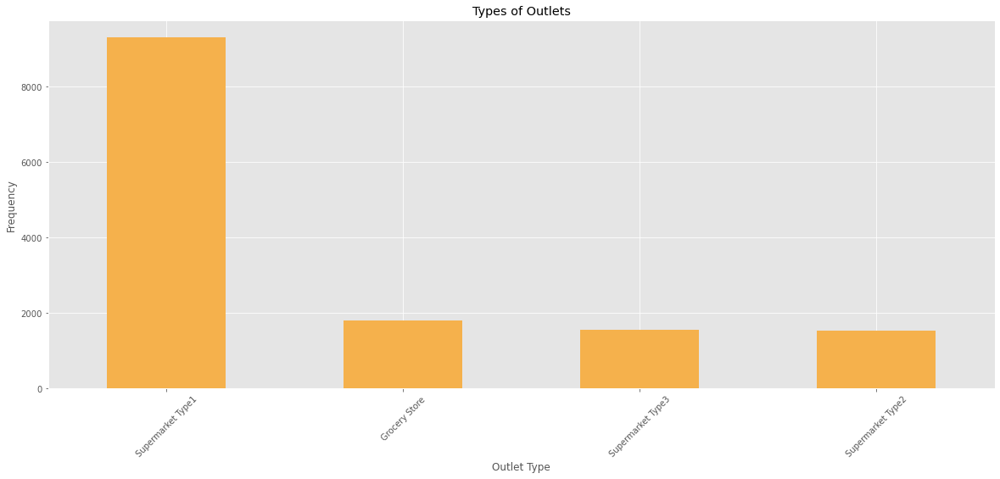

In [99]:
plt.figure(figsize=(20,8))

df['Outlet_Type'].value_counts().plot(kind='bar', title="Types of Outlets", color="#F5B14C")
plt.xlabel("Outlet Type")
plt.ylabel("Frequency")
plt.xticks(rotation=45)
plt.show()

In [100]:
# The most visible type of BigMart is SuperMarket Type1

#### Outlet _Establishment_Year

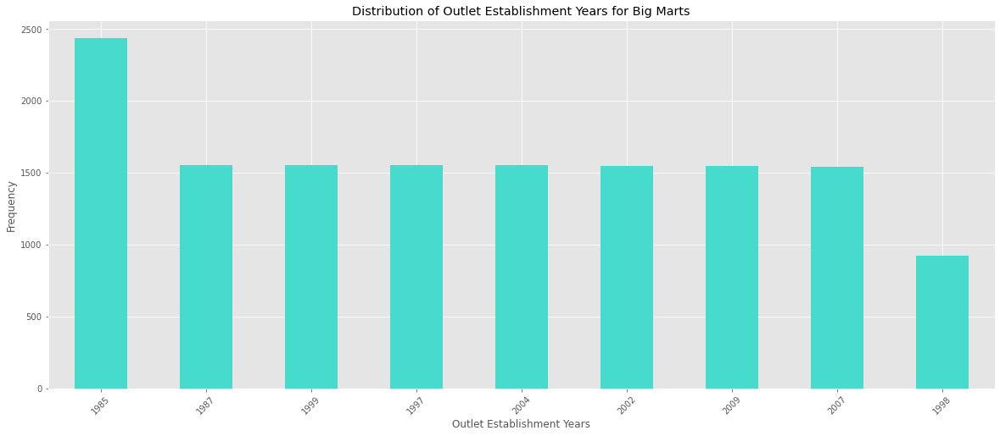

In [101]:
plt.figure(figsize=(20,8))

# Using the Artist Layer
df['Outlet_Establishment_Year'].value_counts().plot(kind="bar",  color="#47DBCD", title="Distribution of Outlet Establishment Years for Big Marts")
plt.xlabel("Outlet Establishment Years")
plt.ylabel("Frequency")
plt.xticks(rotation="45")

plt.show()

In [102]:
# We see that there are most number of Big Mart Establishments in the year 1985 after which there has been fewer Big Market Establishments
# In 1998 however, there has been least number of Big Market Establishments

### Numeric

In [103]:
# Find the numeric data in the dataset
df.describe(exclude="object").columns

Index(['Item_Weight', 'Item_Visibility', 'Item_MRP',
       'Outlet_Establishment_Year', 'Item_Outlet_Sales'],
      dtype='object')

#### Item_Weight

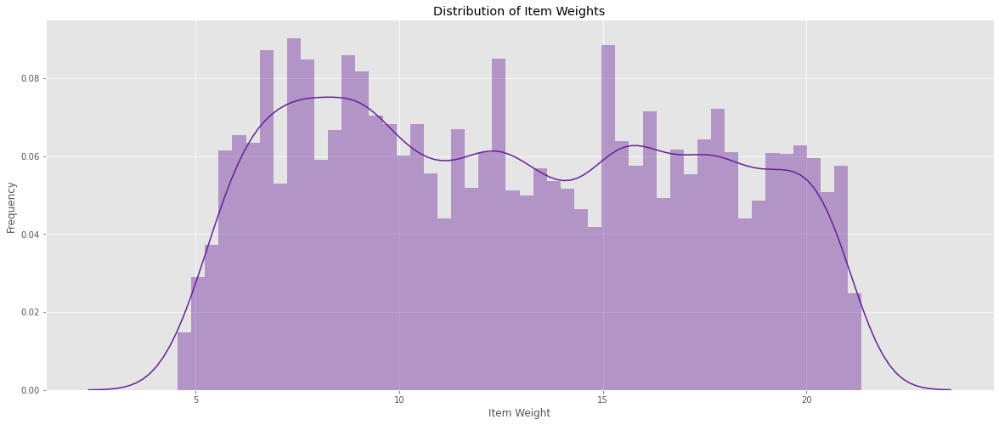

In [104]:
plt.figure(figsize=(20,8))

# Using the Artist Layer
ax = sns.distplot(df['Item_Weight'], color="#661D98", bins=50)
ax.set_xlabel("Item Weight")
ax.set_ylabel("Frequency")
ax.set_title("Distribution of Item Weights")

# Remove top and right borders
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.show()

In [105]:
# The Item Weigh distribution seems to have some hidden categories however the distinction of the categories and well as the categories cannot be made at the moment.
# Also, the distribution does not seem to be Normal as presumed from 5 point summary

#### Item_Visibility

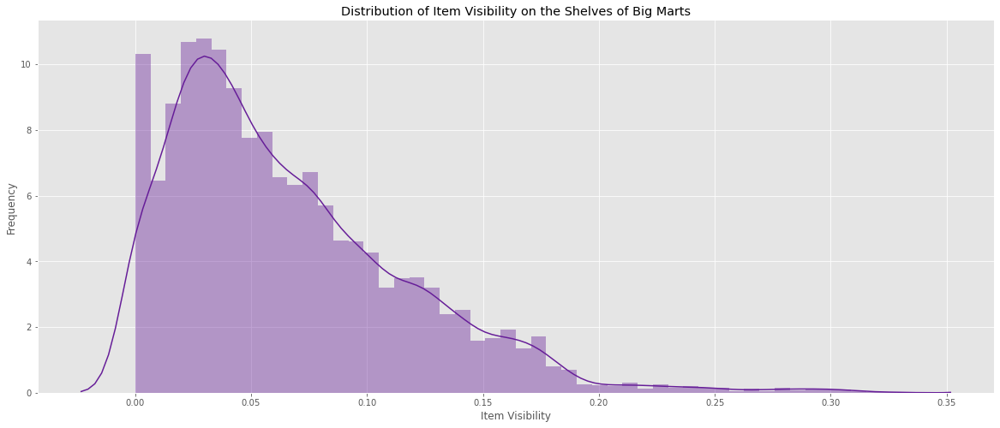

In [106]:
plt.figure(figsize=(20,8))

# Using the Artist Layer
ax = sns.distplot(df['Item_Visibility'], color="#661D98", bins=50)
ax.set_xlabel("Item Visibility")
ax.set_ylabel("Frequency")
ax.set_title("Distribution of Item Visibility on the Shelves of Big Marts")

# Remove top and right borders
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.show()

In [107]:
# As presumed from the 5 point summary, Visibility of Items is highly right-skewed
# Most items have a lower visibility - these items are the small sized food items
# There are items that have a higher visibility - these are the bigger items which occupy more shelf space
# Visibility of products is skewed because bigger products will capture more area in the store and will be very much visible in comparison to small products like Vegetables.

#### Item_MRP

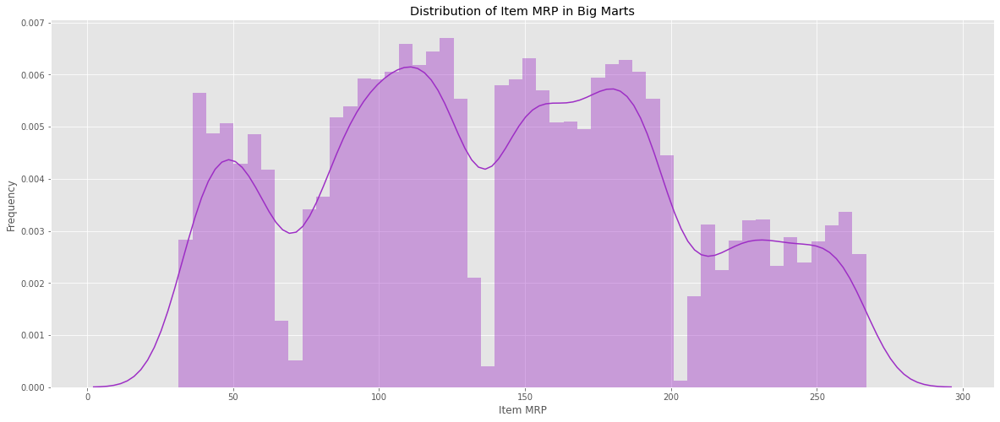

In [108]:
plt.figure(figsize=(20,8))

# Using the Artist Layer
ax = sns.distplot(df['Item_MRP'], color="#9D2EC5", bins=50)
ax.set_xlabel("Item MRP")
ax.set_ylabel("Frequency")
ax.set_title("Distribution of Item MRP in Big Marts")

# Remove top and right borders
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.show()

In [109]:
# We can see a clear distinction between categories of MRP's of food in Big Marts
# We can see 4 clear categories of Items based on MRP
# Need to inspect further about these categories

df.Item_MRP.describe()

count    14204.000000
mean       141.004977
std         62.086938
min         31.290000
25%         94.012000
50%        142.247000
75%        185.855600
max        266.888400
Name: Item_MRP, dtype: float64

#### Item_Outlet_Sales

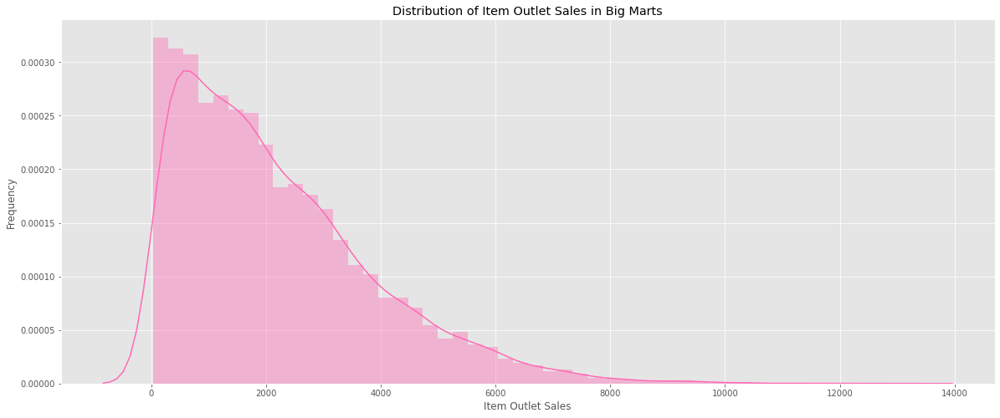

In [110]:
plt.figure(figsize=(20,8))

# Using the Artist Layer
ax = sns.distplot(df['Item_Outlet_Sales'], color="hotpink")
ax.set_xlabel("Item Outlet Sales")
ax.set_ylabel("Frequency")
ax.set_title("Distribution of Item Outlet Sales in Big Marts")

# Remove top and right borders
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

plt.show()

In [111]:
# Check the Dist of Sales
train.Item_Outlet_Sales.describe()

# Mean>Median>Mode - Positively Skewed Data.
# Mean< Median < Mode - Negatively Skewed Data

# Most items cost less while there are some items which cost more making the item sales right-skewed

count     8523.000000
mean      2181.288914
std       1706.499616
min         33.290000
25%        834.247400
50%       1794.331000
75%       3101.296400
max      13086.964800
Name: Item_Outlet_Sales, dtype: float64

## Bivariate Analysis

In [112]:
# Analysing Predictor (Item_Outlet_Sales) VS Independent Variables

### Categoric VS Target

#### Item_identifier

In [113]:
df[['Item_Outlet_Sales','Item_Identifier']].groupby(['Item_Identifier']).describe().T

Item_Identifier               DRA12        DRA24        DRA59      DRB01  \
Item_Outlet_Sales count     6.00000     7.000000     8.000000     3.0000   
                  mean   1843.60020  2246.218971  2614.430150  1518.0240   
                  std    1348.36543  1951.090357  2460.381611   948.7650   
                  min     283.63080   327.573600   185.092400   569.2590   
                  25%     886.34625   737.040600   555.277200  1043.6415   
                  50%    1772.69250  1146.507600  1850.924000  1518.0240   
                  75%    2552.67720  3930.883200  4442.217600  1992.4065   
                  max    3829.01580  4913.604000  7033.511200  2466.7890   

Item_Identifier                DRB13        DRB24        DRB25        DRB48  \
Item_Outlet_Sales count     5.000000     4.000000     6.000000     7.000000   
                  mean   2428.838400  3050.695600  1661.503900   622.903457   
                  std    1532.189383  1212.169555   962.955979   357.466992   
                  min     569.259000  1853.587200   214.387600   157.128800   
                  25%     948.765000  2085.285600  1071.938000   451.745300   
                  50%    3415.554000  3089.312000  1875.891500   589.233000   
                  75%    3605.307000  4054.722000  2277.868250   707.079600   
                  max    3605.307000  4170.571200  2787.038800  1296.312600   

Item_Identifier                DRC01        DRC12        DRC13        DRC24  \
Item_Outlet_Sales count     6.000000     4.000000     4.000000     2.000000   
                  mean    862.211000  2237.420900  1632.042250  3152.895900   
                  std     416.608888   950.505852  1002.555585   326.258645   
                  min     443.422800   952.094000   739.038000  2922.196200   
                  25%     517.326600  1951.792700   923.797500  3037.546050   
                  50%     812.941800  2380.235000  1416.489500  3152.895900   
                  75%    1108.557000  2665.863200  2124.734250  3268.245750   
                  max    1478.076000  3237.119600  2956.152000  3383.595600   

Item_Identifier                DRC25        DRC27        DRC36        DRC49  \
Item_Outlet_Sales count     7.000000     6.000000     5.000000     3.000000   
                  mean   1128.816343  2743.428900  3011.812880  2828.318400   
                  std     754.364706  2414.258545  1967.112584  1060.060658   
                  min      85.888200   245.680200  1225.737800  2013.379200   
                  25%     644.161500  1289.821050  1751.054000  2229.098400   
                  50%    1288.323000  1719.761400  1926.159400  2444.817600   
                  75%    1588.931700  4729.343850  4377.635000  3235.788000   
                  max    2061.316800  5896.324800  5778.478200  4026.758400   

Item_Identifier                DRD01        DRD12        DRD13        DRD15  \
Item_Outlet_Sales count     5.000000     7.000000     7.000000     7.000000   
                  mean    851.025560  1576.709514  1232.681143  2522.811314   
                  std     414.644664   677.928209   885.437476  1384.005152   
                  min     386.829800   638.502200   575.251200   697.092600   
                  25%     552.614000  1185.789800   703.084800  1394.185200   
                  50%     828.921000  1459.433600   958.752000  3020.734600   
                  75%    1049.966600  1961.113900  1310.294400  3601.645100   
                  max    1436.796400  2645.223400  3068.006400  3950.191400   

Item_Identifier                DRD24        DRD25        DRD27        DRD37  \
Item_Outlet_Sales count     7.000000     8.000000     5.000000     7.000000   
                  mean   1965.156257  1740.234750  1269.813760   892.172000   
                  std     945.773595   994.008964   825.245389   467.942631   
                  min     141.815400   452.744000   198.408400   186.424000   
                  25%    1701.784800   877.191500   694.429400   582.575

#### Item_Fat_Content

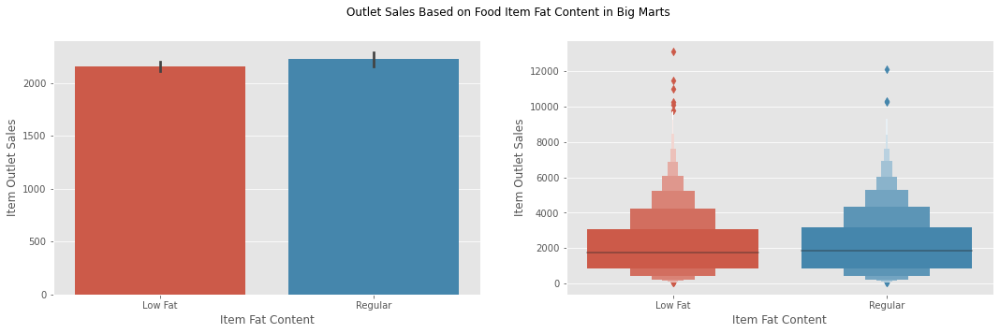

In [114]:
fig, ax = plt.subplots(1,2, figsize=(18,5))
fig.suptitle("Outlet Sales Based on Food Item Fat Content in Big Marts")

sns.barplot(x="Item_Fat_Content", y="Item_Outlet_Sales", data=df, ax=ax[0])
sns.boxenplot(x="Item_Fat_Content", y="Item_Outlet_Sales", data=df, ax=ax[1])
ax[0].set_xlabel("Item Fat Content")
ax[0].set_ylabel("Item Outlet Sales")
ax[1].set_xlabel("Item Fat Content")
ax[1].set_ylabel("Item Outlet Sales")
plt.show()

In [115]:
df[['Item_Outlet_Sales','Item_Fat_Content']].groupby(['Item_Fat_Content']).describe().T

Item_Fat_Content              Low Fat       Regular
Item_Outlet_Sales count   5517.000000   3006.000000
                  mean    2157.711534   2224.561170
                  std     1697.973824   1721.480865
                  min       33.290000     33.955800
                  25%      826.257800    857.550400
                  50%     1765.035800   1844.598900
                  75%     3050.695600   3198.669650
                  max    13086.964800  12117.560000

In [116]:
# Although foods with Low Fat content are available more than Regular food content, however the sales of regualr food items is more
# We see that Item Fat Content has a lot of outliers 

#### Item_Type

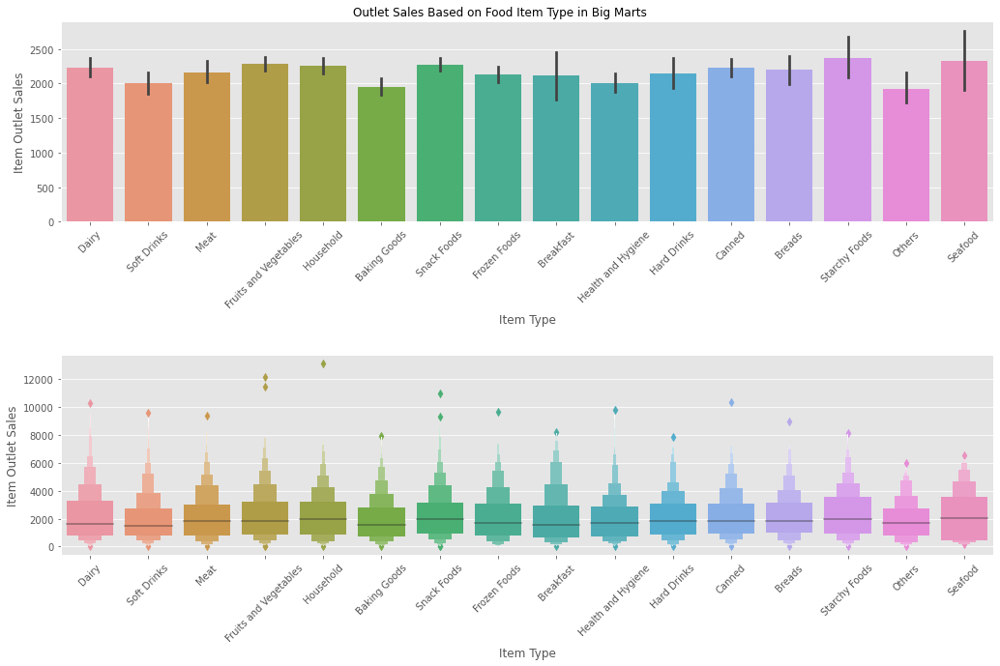

In [117]:
fig, ax = plt.subplots(2,1, figsize=(15,10))
fig.suptitle("Outlet Sales Based on Food Item Type in Big Marts")

sns.barplot(x="Item_Type", y="Item_Outlet_Sales", data=df, ax=ax[0])
ax[0].set_xlabel("Item Type")
ax[0].set_ylabel("Item Outlet Sales")
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation="45")
sns.boxenplot(x="Item_Type", y="Item_Outlet_Sales", data=df, ax=ax[1])
ax[1].set_xlabel("Item Type")
ax[1].set_ylabel("Item Outlet Sales")
ax[1].set_xticklabels(ax[1].get_xticklabels(), rotation="45")
plt.tight_layout(pad=3.0)
plt.show()

In [118]:
df[['Item_Outlet_Sales','Item_Type']].groupby(['Item_Type']).describe().T

Item_Type                Baking Goods       Breads    Breakfast        Canned  \
Item_Outlet_Sales count    648.000000   251.000000   110.000000    649.000000   
                  mean    1952.971207  2204.132226  2111.808651   2225.194904   
                  std     1546.788045  1644.235914  1911.693586   1645.235638   
                  min       37.284800    35.287400    39.948000     37.950600   
                  25%      705.082200   968.739000   679.116000    952.094000   
                  50%     1577.946000  1860.245200  1554.643000   1860.245200   
                  75%     2823.824250  3145.905000  2970.300250   3101.296400   
                  max     7931.675400  8958.339000  8209.314000  10306.584000   

Item_Type                       Dairy  Frozen Foods  Fruits and Vegetables  \
Item_Outlet_Sales count    682.000000    856.000000            1232.000000   
                  mean    2232.542597   2132.867744            2289.009592   
                  std     1884.404698   1724.777720            1799.503459   
                  min       40.613800     36.619000              45.274400   
                  25%      788.973000    808.947000             884.848200   
                  50%     1650.851100   1687.137200            1830.950000   
                  75%     3296.209350   3079.491450            3227.132600   
                  max    10256.649000   9678.068800           12117.560000   

Item_Type                Hard Drinks  Health and Hygiene     Household  \
Item_Outlet_Sales count   214.000000          520.000000    910.000000   
                  mean   2139.221622         2010.000265   2258.784300   
                  std    1606.191587         1553.633063   1692.245757   
                  min      37.950600           34.621600     33.290000   
                  25%     834.913200          758.845550    853.389150   
                  50%    1816.635300         1669.493500   1981.420800   
                  75%    3071.335400         2884.578500   3236.786700   
                  max    7843.124000         9779.936200  13086.964800   

Item_Type                       Meat       Others      Seafood   Snack Foods  \
Item_Outlet_Sales count   425.000000   169.000000    64.000000   1200.000000   
                  mean   2158.977911  1926.139702  2326.065928   2277.321739   
                  std    1695.231081  1431.860471  1842.988719   1705.121755   
                  min      47.937600    39.948000   149.805000     33.955800   
                  25%     782.980800   790.970400   473.383800    918.804000   
                  50%    1829.618400  1713.769200  2055.324600   1944.136000   
                  75%    3036.048000  2719.793000  3589.327800   3143.574700   
                  max    9390.443200  6008.845000  6503.534400  10993.689600   

Item_Type                Soft Drinks  Starchy Foods  
Item_Outlet_Sales count   445.000000     148.000000  
                  mean   2006.511735    2374.332773  
                  std    1674.249752    1773.945328  
                  min      33.290000      58.590400  
                  25%     771.662200     958.752000  
                  50%    1518.024000    1968.104800  
                  75%    2759.075200    3592.656800  
                  max    9554.230000    8132.081200

In [119]:
# We dont see a lot of difference in the sales of various food items however Starchy foods seem to be most sold and Others food items seems to be least sold
# Other food items are at an average sold at a lesser amount than other food categories
# We also observe that although Seafood has the least quantity but seem to be quite profitable (most expensive) in terms of sales
# We also see that houshold items seem to have items at the higest and lowest price bracket

#### Outlet_Id

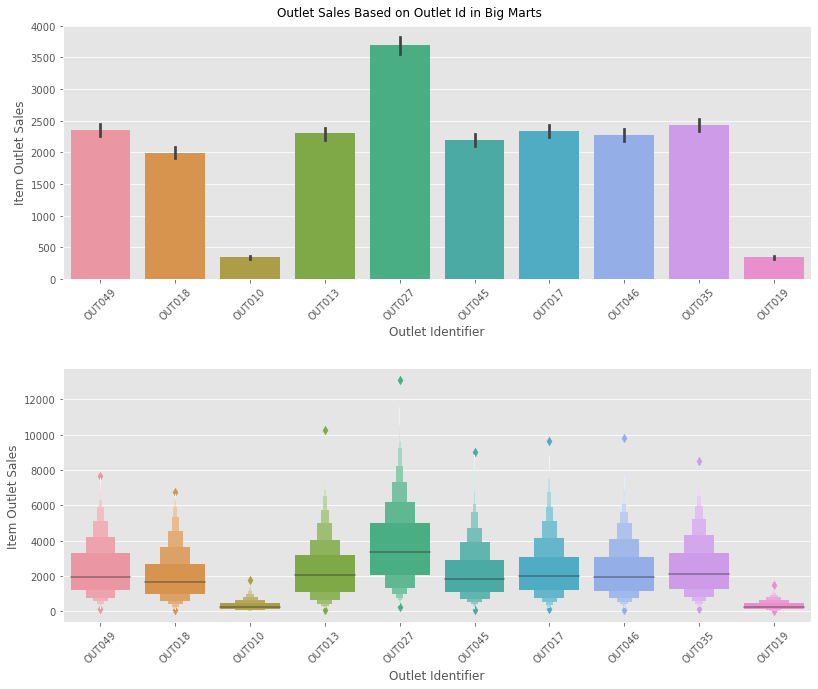

In [120]:
fig, ax = plt.subplots(2,1, figsize=(12,10))
fig.suptitle("Outlet Sales Based on Outlet Id in Big Marts")

sns.barplot(x="Outlet_Identifier", y="Item_Outlet_Sales", data=df, ax=ax[0])
ax[0].set_xlabel("Outlet Identifier")
ax[0].set_ylabel("Item Outlet Sales")
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation="45")
sns.boxenplot(x="Outlet_Identifier", y="Item_Outlet_Sales", data=df, ax=ax[1])
ax[1].set_xlabel("Outlet Identifier")
ax[1].set_ylabel("Item Outlet Sales")
ax[1].set_xticklabels(ax[1].get_xticklabels(), rotation="45")
plt.tight_layout(pad=3.0)
plt.show()

In [121]:
df[['Item_Outlet_Sales','Outlet_Identifier']].groupby(['Outlet_Identifier']).describe().T

Outlet_Identifier             OUT010        OUT013       OUT017       OUT018  \
Item_Outlet_Sales count   555.000000    932.000000   926.000000   928.000000   
                  mean    339.351662   2298.995256  2340.675263  1995.498739   
                  std     271.014855   1533.531664  1550.778025  1375.932889   
                  min      33.290000     73.238000   143.812800    69.243200   
                  25%     154.132700   1072.603800  1195.943250   981.555650   
                  50%     250.340800   2050.664000  2005.056700  1655.178800   
                  75%     455.407200   3166.378350  3096.469350  2702.648650   
                  max    1775.688600  10256.649000  9664.752800  6768.522800   

Outlet_Identifier             OUT019        OUT027       OUT035       OUT045  \
Item_Outlet_Sales count   528.000000    935.000000   930.000000   929.000000   
                  mean    340.329723   3694.038558  2438.841866  2192.384798   
                  std     249.979449   2127.760054  1538.512533  1462.399658   
                  min      33.955800    241.685400   113.851800    99.870000   
                  25%     153.633350   2044.338900  1238.887350  1068.609000   
                  50%     265.321300   3364.953200  2109.254400  1834.944800   
                  75%     460.733600   4975.523400  3310.357600  2929.520000   
                  max    1482.070800  13086.964800  8479.628800  8994.958000   

Outlet_Identifier             OUT046       OUT049  
Item_Outlet_Sales count   930.000000   930.000000  
                  mean   2277.844267  2348.354635  
                  std    1488.405631  1513.289464  
                  min     101.867400   111.854400  
                  25%    1137.186400  1182.793700  
                  50%    1945.800500  1966.107400  
                  75%    3095.637100  3281.728200  
                  max    9779.936200  7646.047200

In [122]:
# As perceived from The Univariate Analysis of Outlet_Id, we confirm that OUT010 and OUT019 have the least sales and OUT027 has the most sales as compared to other outlets 
# Also we observe that OUT010 and OUT010 are much lesser in number than other outlets while OUT027 seems to have most number of items sold justifying the sales 

#### Outlet_Size

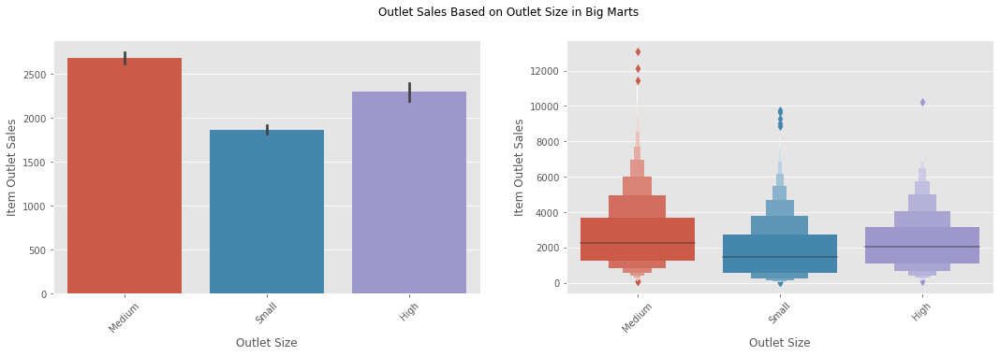

In [123]:
fig, ax = plt.subplots(1,2, figsize=(18,5))
fig.suptitle("Outlet Sales Based on Outlet Size in Big Marts")

sns.barplot(x="Outlet_Size", y="Item_Outlet_Sales", data=df, ax=ax[0])
sns.boxenplot(x="Outlet_Size", y="Item_Outlet_Sales", data=df, ax=ax[1])
ax[0].set_xlabel("Outlet Size")
ax[0].set_ylabel("Item Outlet Sales")
ax[0].set_xticklabels(ax[0].get_xticklabels(), rotation="45")
ax[1].set_xlabel("Outlet Size")
ax[1].set_ylabel("Item Outlet Sales")
ax[1].set_xticklabels(ax[1].get_xticklabels(), rotation="45")
plt.show()

In [124]:
df[['Item_Outlet_Sales','Outlet_Size','Outlet_Identifier']].groupby(['Outlet_Size','Outlet_Identifier']).describe().T

Outlet_Size                      High       Medium                             \
Outlet_Identifier              OUT013       OUT018        OUT027       OUT049   
Item_Outlet_Sales count    932.000000   928.000000    935.000000   930.000000   
                  mean    2298.995256  1995.498739   3694.038558  2348.354635   
                  std     1533.531664  1375.932889   2127.760054  1513.289464   
                  min       73.238000    69.243200    241.685400   111.854400   
                  25%     1072.603800   981.555650   2044.338900  1182.793700   
                  50%     2050.664000  1655.178800   3364.953200  1966.107400   
                  75%     3166.378350  2702.648650   4975.523400  3281.728200   
                  max    10256.649000  6768.522800  13086.964800  7646.047200   

Outlet_Size                    Small                                         \
Outlet_Identifier             OUT010       OUT017       OUT019       OUT035   
Item_Outlet_Sales count   555.000000   926.000000   528.000000   930.000000   
                  mean    339.351662  2340.675263   340.329723  2438.841866   
                  std     271.014855  1550.778025   249.979449  1538.512533   
                  min      33.290000   143.812800    33.955800   113.851800   
                  25%     154.132700  1195.943250   153.633350  1238.887350   
                  50%     250.340800  2005.056700   265.321300  2109.254400   
                  75%     455.407200  3096.469350   460.733600  3310.357600   
                  max    1775.688600  9664.752800  1482.070800  8479.628800   

Outlet_Size                                        
Outlet_Identifier             OUT045       OUT046  
Item_Outlet_Sales count   929.000000   930.000000  
                  mean   2192.384798  2277.844267  
                  std    1462.399658  1488.405631  
                  min      99.870000   101.867400  
                  25%    1068.609000  1137.186400  
                  50%    1834.944800  1945.800500  
                  75%    2929.520000  3095.637100  
                  max    8994.958000  9779.936200

In [125]:
# While we saw that Medium sized outlets were most avaliable while high sized outlets were least available, we see that medium does contribue to highest sales, followed by high and small sized outlets
# We can further infer that OUT027 is a medium sized outlet contributing maximum sales while OUT019 is a small outlet contributing minimum sales

#### Outlet_Location_Type

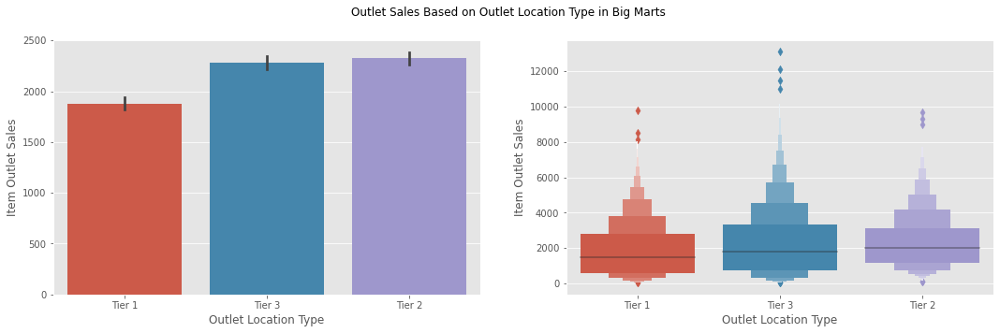

In [126]:
fig, ax = plt.subplots(1,2, figsize=(18,5))
fig.suptitle("Outlet Sales Based on Outlet Location Type in Big Marts")

sns.barplot(x="Outlet_Location_Type", y="Item_Outlet_Sales", data=df, ax=ax[0])
sns.boxenplot(x="Outlet_Location_Type", y="Item_Outlet_Sales", data=df, ax=ax[1])
ax[0].set_xlabel("Outlet Location Type")
ax[0].set_ylabel("Item Outlet Sales")
ax[0].set_xticklabels(ax[0].get_xticklabels())
ax[1].set_xlabel("Outlet Location Type")
ax[1].set_ylabel("Item Outlet Sales")
ax[1].set_xticklabels(ax[1].get_xticklabels())
plt.show()

In [127]:
df[['Item_Outlet_Sales','Outlet_Size','Outlet_Identifier','Outlet_Location_Type']].groupby(['Outlet_Size','Outlet_Location_Type','Outlet_Identifier']).mean()

Item_Outlet_Sales
Outlet_Size Outlet_Location_Type Outlet_Identifier                   
High        Tier 3               OUT013                   2298.995256
Medium      Tier 1               OUT049                   2348.354635
            Tier 3               OUT018                   1995.498739
                                 OUT027                   3694.038558
Small       Tier 1               OUT019                    340.329723
                                 OUT046                   2277.844267
            Tier 2               OUT017                   2340.675263
                                 OUT035                   2438.841866
                                 OUT045                   2192.384798
            Tier 3               OUT010                    339.351662

In [128]:
# We saw that Outlets from tier3 were most in number followed by tier2 and tier1, however when compared with sales outlets in Tier2 cities showed slightly higher sales than Tiier3
# We also see that OUT027 is from Tier3 and OUT019 is from Tier1 cities

#### Outlet_Type

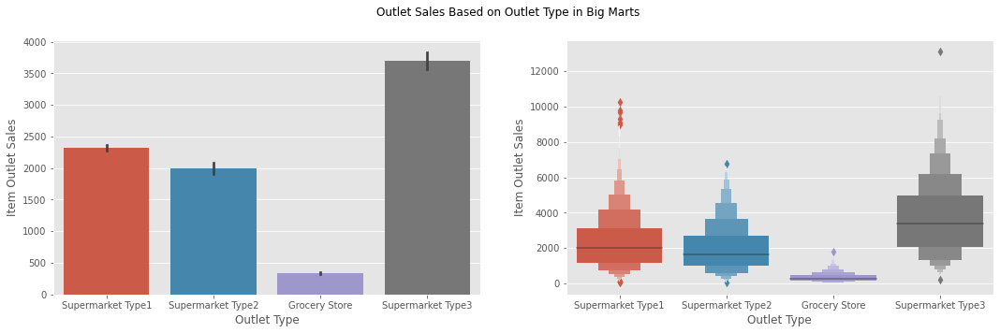

In [129]:
fig, ax = plt.subplots(1,2, figsize=(18,5))
fig.suptitle("Outlet Sales Based on Outlet Type in Big Marts")

sns.barplot(x="Outlet_Type", y="Item_Outlet_Sales", data=df, ax=ax[0])
sns.boxenplot(x="Outlet_Type", y="Item_Outlet_Sales", data=df, ax=ax[1])
ax[0].set_xlabel("Outlet Type")
ax[0].set_ylabel("Item Outlet Sales")
ax[0].set_xticklabels(ax[0].get_xticklabels())
ax[1].set_xlabel("Outlet Type")
ax[1].set_ylabel("Item Outlet Sales")
ax[1].set_xticklabels(ax[1].get_xticklabels())
plt.show()

In [130]:
df[['Item_Outlet_Sales','Outlet_Size','Outlet_Identifier','Outlet_Location_Type','Outlet_Type']].groupby(['Outlet_Size','Outlet_Location_Type','Outlet_Type','Outlet_Identifier']).mean()

Item_Outlet_Sales
Outlet_Size Outlet_Location_Type Outlet_Type       Outlet_Identifier                   
High        Tier 3               Supermarket Type1 OUT013                   2298.995256
Medium      Tier 1               Supermarket Type1 OUT049                   2348.354635
            Tier 3               Supermarket Type2 OUT018                   1995.498739
                                 Supermarket Type3 OUT027                   3694.038558
Small       Tier 1               Grocery Store     OUT019                    340.329723
                                 Supermarket Type1 OUT046                   2277.844267
            Tier 2               Supermarket Type1 OUT017                   2340.675263
                                                   OUT035                   2438.841866
                                                   OUT045                   2192.384798
            Tier 3               Grocery Store     OUT010                    339.351662

In [131]:
# Although Supermarket Type1 stores are the most available but Supermarket Type3 seems to have made more sales than the rest
# Grocery stores however show least promising sales
# This further proves that the most profitable outlet OUT027 is a Supermarket3 while the least profitable outlet OUT019 is a Grocery Store

#### Outlet_Establishment_Year

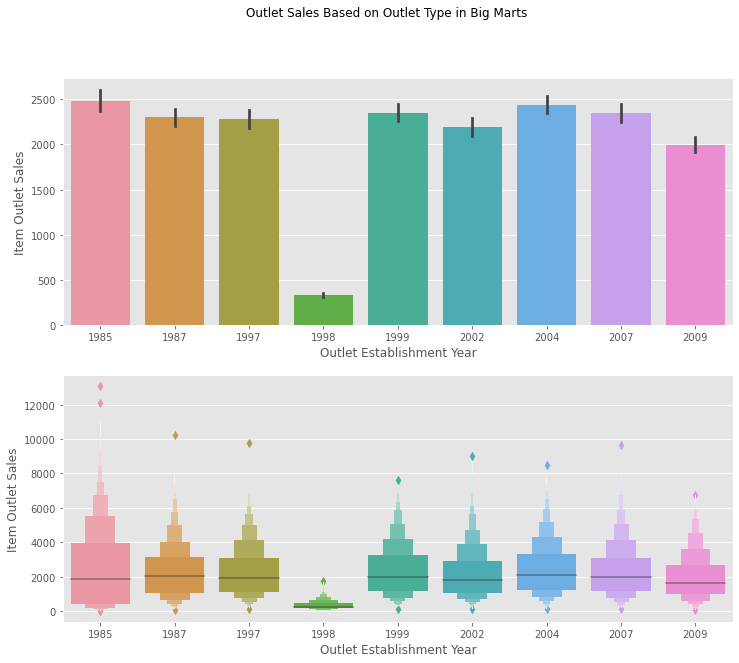

In [132]:
fig, ax = plt.subplots(2,1, figsize=(12,10))
fig.suptitle("Outlet Sales Based on Outlet Type in Big Marts")

sns.barplot(x="Outlet_Establishment_Year", y="Item_Outlet_Sales", data=df, ax=ax[0])
sns.boxenplot(x="Outlet_Establishment_Year", y="Item_Outlet_Sales", data=df, ax=ax[1])
ax[0].set_xlabel("Outlet Establishment Year")
ax[0].set_ylabel("Item Outlet Sales")
ax[0].set_xticklabels(ax[0].get_xticklabels())
ax[1].set_xlabel("Outlet Establishment Year")
ax[1].set_ylabel("Item Outlet Sales")
ax[1].set_xticklabels(ax[1].get_xticklabels())
plt.show()

In [133]:
# We see that most number of outlets establishemnts and  most profitable year of Big Mart Establishments is in the year 1985 
# In 1998 however, there has been least number of Big Market Establishments and has been the least profitable year in terms of sales

### Numeric VS Target

#### Item_Weight 

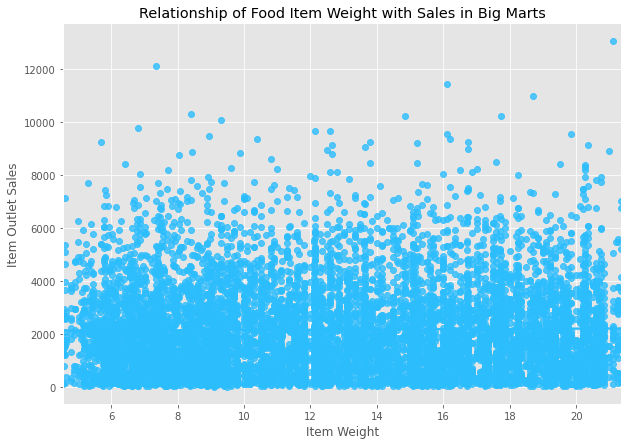

In [134]:
plt.figure(figsize=(10,7))
ax = sns.regplot(x="Item_Weight", y="Item_Outlet_Sales", data=df, color="#2CBDFE")
ax.set_xlabel("Item Weight")
ax.set_ylabel("Item Outlet Sales")
ax.set_title("Relationship of Food Item Weight with Sales in Big Marts")
plt.show()

In [135]:
# There is no specific pattern of Sales with Item Weight

#### Item_Visibility

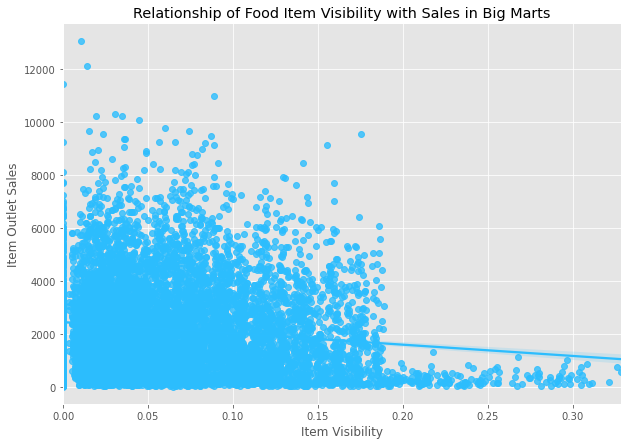

In [136]:
plt.figure(figsize=(10,7))
ax = sns.regplot(x="Item_Visibility", y="Item_Outlet_Sales", data=df, color="#2CBDFE")
ax.set_xlabel("Item Visibility")
ax.set_ylabel("Item Outlet Sales")
ax.set_title("Relationship of Food Item Visibility with Sales in Big Marts")
plt.show()

In [137]:
# We observe that there are food items with 0 visibility but still have sales, however this is an error which would need to be addressed later in the analsis
# It might signify that these items have been sold off and are off the shelves, hence have no visibility
# This anomaly will be looked into later

#### Item_MRP

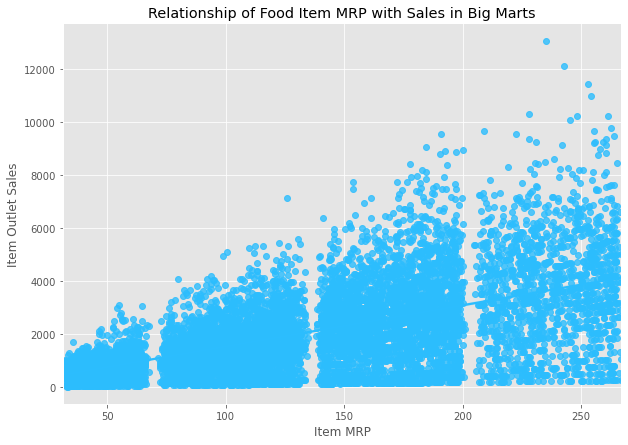

In [138]:
plt.figure(figsize=(10,7))
ax = sns.regplot(x="Item_MRP", y="Item_Outlet_Sales", data=df, color="#2CBDFE")
ax.set_xlabel("Item MRP")
ax.set_ylabel("Item Outlet Sales")
ax.set_title("Relationship of Food Item MRP with Sales in Big Marts")
plt.show()

In [139]:
# As mentioned earlier there existes 4 categories of Items based on MRP
# ITEM MRP is not given for a single item. These Prices are Combined
# Total Prices of certain quantities.

# Handling Anomalies in the data

In [140]:
# Remove 0's from Item_Visibility

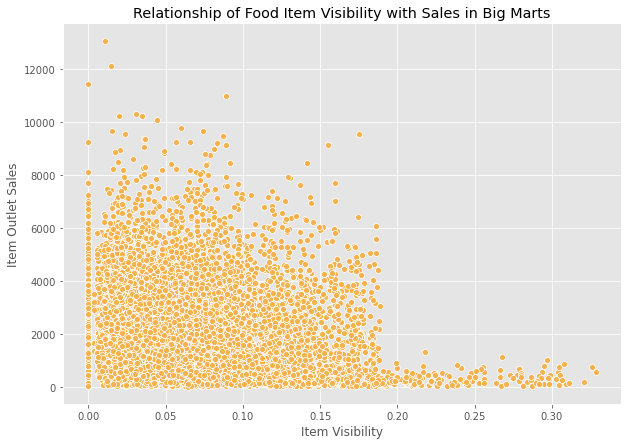

In [141]:
plt.figure(figsize=(10,7))
ax = sns.scatterplot(x="Item_Visibility", y="Item_Outlet_Sales", data=df, color="#F5B14C")
ax.set_xlabel("Item Visibility")
ax.set_ylabel("Item Outlet Sales")
ax.set_title("Relationship of Food Item Visibility with Sales in Big Marts")
plt.show()

In [142]:
df["Item_Visibility"] = df.groupby("Item_Identifier")["Item_Visibility"].transform(lambda x: x.replace(to_replace = 0, value = x.mean()))

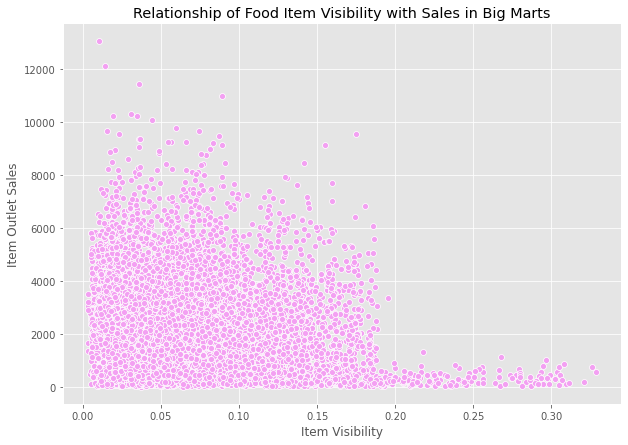

In [143]:
plt.figure(figsize=(10,7))
ax = sns.scatterplot(x="Item_Visibility", y="Item_Outlet_Sales", data=df, color="#F3A0F2")
ax.set_xlabel("Item Visibility")
ax.set_ylabel("Item Outlet Sales")
ax.set_title("Relationship of Food Item Visibility with Sales in Big Marts")
plt.show()

In [144]:
# we can see that the 0's have been sucessfully removed

# Handling Categoric Variables

In [145]:
df.head()

,Item_Identifier,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Identifier,Outlet_Establishment_Year,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales,Train_Test_Label
0,FDA15,9.30,Low Fat,0.016047,Dairy,249.8092,OUT049,1999,Medium,Tier 1,Supermarket Type1,3735.1380,Train
1,DRC01,5.92,Regular,0.019278,Soft Drinks,48.2692,OUT018,2009,Medium,Tier 3,Supermarket Type2,443.4228,Train
2,FDN15,17.50,Low Fat,0.016760,Meat,141.6180,OUT049,1999,Medium,Tier 1,Supermarket Type1,2097.2700,Train
3,FDX07,19.20,Regular,0.017834,Fruits and Vegetables,182.0950,OUT010,1998,Small,Tier 3,Grocery Store,732.3800,Train
4,NCD19,8.93,Low Fat,0.009780,Household,53.8614,OUT013,1987,High,Tier 3,Supermarket Type1,994.7052,Train


## Item_Fat_Content

In [146]:
# This is only for Item_Fat_Content
df['Item_Fat_Content'].replace({"Low Fat":0, "Regular":1}, inplace=True)

In [147]:
df['Item_Fat_Content'].value_counts()

0    9185
1    5019
Name: Item_Fat_Content, dtype: int64

## Item_Identifier

In [148]:
# Item_Identifier, has got information of items based on their category. 

In [149]:
df['Item_Identifier'].nunique()

1559

In [150]:
# we see that there are 1559 categories, we would further create new feature.
item_cat = []
for i in df['Item_Identifier']:
    item_cat.append(i[:2])

In [151]:
df['Item_Identifier_cat'] = item_cat
df['Item_Identifier_cat'].value_counts()

FD    10201
NC     2686
DR     1317
Name: Item_Identifier_cat, dtype: int64

In [152]:
df.drop(['Item_Identifier'], axis=1, inplace=True)

## Item_Type

In [153]:
df['Item_Type'].value_counts()

Fruits and Vegetables    2013
Snack Foods              1989
Household                1548
Frozen Foods             1426
Dairy                    1136
Baking Goods             1086
Canned                   1084
Health and Hygiene        858
Meat                      736
Soft Drinks               726
Breads                    416
Hard Drinks               362
Others                    280
Starchy Foods             269
Breakfast                 186
Seafood                    89
Name: Item_Type, dtype: int64

In [154]:
# Item_Type seems of nominal nature, so we can use one hot encoding but still we would get a large number of attributes 
# which would have structural multi-coolinearity
# We would address that by binning Item_Type

In [155]:
perishables = ['Dairy', 'Meat', 'Fruits and Vegetables','Breakfast',
              'Breads','Seafood']

In [156]:
def Item_Type_bin(x):
    if x in perishables:
        x="Perishables"
    else:
        x="Non_Perishables"
    return x

In [157]:
df['Item_Type'] = df['Item_Type'].apply(Item_Type_bin)

In [158]:
df['Item_Type'].value_counts()

Non_Perishables    9628
Perishables        4576
Name: Item_Type, dtype: int64

## Outlet_Establishment_Year

In [159]:
df['Outlet_Establishment_Year'].value_counts()

1985    2439
1987    1553
1999    1550
1997    1550
2004    1550
2002    1548
2009    1546
2007    1543
1998     925
Name: Outlet_Establishment_Year, dtype: int64

In [160]:
# Let us modify this attribute to describe the years before the current year
# since the data is for 2013 sales, we can use it be subtract with Outlet_Establishment to find the number of years the outlet existed
df['Outlet_Age'] = 2013 - df['Outlet_Establishment_Year']

In [161]:
df['Outlet_Age'].value_counts()

28    2439
26    1553
14    1550
9     1550
16    1550
11    1548
4     1546
6     1543
15     925
Name: Outlet_Age, dtype: int64

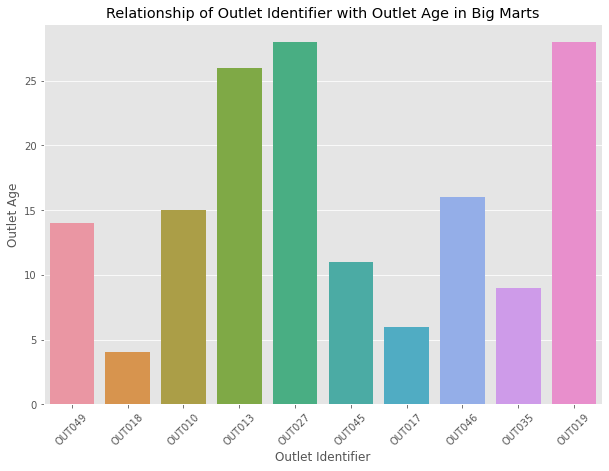

In [162]:
plt.figure(figsize=(10,7))
sns.barplot(x='Outlet_Identifier', y="Outlet_Age", data=df)
plt.xticks(rotation=45)
plt.xlabel("Outlet Identifier")
plt.ylabel("Outlet Age")
plt.title("Relationship of Outlet Identifier with Outlet Age in Big Marts")
plt.show()

In [163]:
df.drop(['Outlet_Establishment_Year'], axis=1, inplace=True)

## Outlet_Identifier

In [164]:
df['Outlet_Identifier'].value_counts()

OUT027    1559
OUT013    1553
OUT035    1550
OUT049    1550
OUT046    1550
OUT045    1548
OUT018    1546
OUT017    1543
OUT010     925
OUT019     880
Name: Outlet_Identifier, dtype: int64

In [165]:
# If we try to one-hot encode the Outlet_Identifier then we get multiple columns 
# which would raise the issue of structural multi-coolinearity, so we will bin the categories

In [166]:
# we wont need this column as we already have other attributes to describe outlets
# we will drop it.

In [167]:
df.drop(['Outlet_Identifier'], axis=1, inplace=True)

In [168]:
df.head()

,Item_Weight,Item_Fat_Content,Item_Visibility,Item_Type,Item_MRP,Outlet_Size,Outlet_Location_Type,Outlet_Type,Item_Outlet_Sales,Train_Test_Label,Item_Identifier_cat,Outlet_Age
0,9.30,0,0.016047,Perishables,249.8092,Medium,Tier 1,Supermarket Type1,3735.1380,Train,FD,14
1,5.92,1,0.019278,Non_Perishables,48.2692,Medium,Tier 3,Supermarket Type2,443.4228,Train,DR,4
2,17.50,0,0.016760,Perishables,141.6180,Medium,Tier 1,Supermarket Type1,2097.2700,Train,FD,14
3,19.20,1,0.017834,Perishables,182.0950,Small,Tier 3,Grocery Store,732.3800,Train,FD,15
4,8.93,0,0.009780,Non_Perishables,53.8614,High,Tier 3,Supermarket Type1,994.7052,Train,NC,26


## Rest

In [169]:
for i in df.describe(include="object").columns:
    print("\n----------",i,"----------")
    print(df[i].value_counts(),"\n")


---------- Item_Type ----------
Non_Perishables    9628
Perishables        4576
Name: Item_Type, dtype: int64 


---------- Outlet_Size ----------
Small     7996
Medium    4655
High      1553
Name: Outlet_Size, dtype: int64 


---------- Outlet_Location_Type ----------
Tier 3    5583
Tier 2    4641
Tier 1    3980
Name: Outlet_Location_Type, dtype: int64 


---------- Outlet_Type ----------
Supermarket Type1    9294
Grocery Store        1805
Supermarket Type3    1559
Supermarket Type2    1546
Name: Outlet_Type, dtype: int64 


---------- Train_Test_Label ----------
Train    8523
Test     5681
Name: Train_Test_Label, dtype: int64 


---------- Item_Identifier_cat ----------
FD    10201
NC     2686
DR     1317
Name: Item_Identifier_cat, dtype: int64 



In [170]:
# Off the cateoric variables that are left out, we see that the categories for each have maximum 3 values, so one-hot encoding makes sense.
# Reducing curse of dimensionality

In [171]:
df2 = pd.get_dummies(df, columns=["Item_Type","Item_Identifier_cat","Outlet_Size","Outlet_Location_Type","Outlet_Type"], drop_first=True)
df2.head()

,Item_Weight,Item_Fat_Content,Item_Visibility,Item_MRP,Item_Outlet_Sales,Train_Test_Label,Outlet_Age,Item_Type_Perishables,Item_Identifier_cat_FD,Item_Identifier_cat_NC,Outlet_Size_Medium,Outlet_Size_Small,Outlet_Location_Type_Tier 2,Outlet_Location_Type_Tier 3,Outlet_Type_Supermarket Type1,Outlet_Type_Supermarket Type2,Outlet_Type_Supermarket Type3
0,9.30,0,0.016047,249.8092,3735.1380,Train,14,1,1,0,1,0,0,0,1,0,0
1,5.92,1,0.019278,48.2692,443.4228,Train,4,0,0,0,1,0,0,1,0,1,0
2,17.50,0,0.016760,141.6180,2097.2700,Train,14,1,1,0,1,0,0,0,1,0,0
3,19.20,1,0.017834,182.0950,732.3800,Train,15,1,1,0,0,1,0,1,0,0,0
4,8.93,0,0.009780,53.8614,994.7052,Train,26,0,0,1,0,0,0,1,1,0,0


# Splitting into Train and Test

In [172]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.metrics import r2_score , mean_squared_error , mean_absolute_error
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression, Lasso , LassoCV , Ridge , RidgeCV, ElasticNetCV, ElasticNet

In [173]:
df2.columns

Index(['Item_Weight', 'Item_Fat_Content', 'Item_Visibility', 'Item_MRP',
       'Item_Outlet_Sales', 'Train_Test_Label', 'Outlet_Age',
       'Item_Type_Perishables', 'Item_Identifier_cat_FD',
       'Item_Identifier_cat_NC', 'Outlet_Size_Medium', 'Outlet_Size_Small',
       'Outlet_Location_Type_Tier 2', 'Outlet_Location_Type_Tier 3',
       'Outlet_Type_Supermarket Type1', 'Outlet_Type_Supermarket Type2',
       'Outlet_Type_Supermarket Type3'],
      dtype='object')

In [174]:
# Split the data into train and test

df3 = df2.iloc[:,:]
df3_train = df3[df3['Train_Test_Label']=='Train']
df3_test = df3[df3['Train_Test_Label']=='Test']

In [175]:
df3_train.head()

,Item_Weight,Item_Fat_Content,Item_Visibility,Item_MRP,Item_Outlet_Sales,Train_Test_Label,Outlet_Age,Item_Type_Perishables,Item_Identifier_cat_FD,Item_Identifier_cat_NC,Outlet_Size_Medium,Outlet_Size_Small,Outlet_Location_Type_Tier 2,Outlet_Location_Type_Tier 3,Outlet_Type_Supermarket Type1,Outlet_Type_Supermarket Type2,Outlet_Type_Supermarket Type3
0,9.30,0,0.016047,249.8092,3735.1380,Train,14,1,1,0,1,0,0,0,1,0,0
1,5.92,1,0.019278,48.2692,443.4228,Train,4,0,0,0,1,0,0,1,0,1,0
2,17.50,0,0.016760,141.6180,2097.2700,Train,14,1,1,0,1,0,0,0,1,0,0
3,19.20,1,0.017834,182.0950,732.3800,Train,15,1,1,0,0,1,0,1,0,0,0
4,8.93,0,0.009780,53.8614,994.7052,Train,26,0,0,1,0,0,0,1,1,0,0


In [176]:
df3_test.head()

,Item_Weight,Item_Fat_Content,Item_Visibility,Item_MRP,Item_Outlet_Sales,Train_Test_Label,Outlet_Age,Item_Type_Perishables,Item_Identifier_cat_FD,Item_Identifier_cat_NC,Outlet_Size_Medium,Outlet_Size_Small,Outlet_Location_Type_Tier 2,Outlet_Location_Type_Tier 3,Outlet_Type_Supermarket Type1,Outlet_Type_Supermarket Type2,Outlet_Type_Supermarket Type3
8523,20.750,0,0.007565,107.8622,NaN,Test,14,0,1,0,1,0,0,0,1,0,0
8524,8.300,1,0.038428,87.3198,NaN,Test,6,1,1,0,0,1,1,0,1,0,0
8525,14.600,0,0.099575,241.7538,NaN,Test,15,0,0,1,0,1,0,1,0,0,0
8526,7.315,0,0.015388,155.0340,NaN,Test,6,0,1,0,0,1,1,0,1,0,0
8527,13.600,1,0.118599,234.2300,NaN,Test,28,1,1,0,1,0,0,1,0,0,1


# Export to CSV

In [177]:
df3_train.to_csv('big_train.csv', index=False)
df3_test.to_csv('big_test.csv', index=False)